In [1]:
import numpy as np
import matplotlib.pyplot as plt
from scipy import fft

In [2]:
# create original unit cell lattice vectors
a1 = (np.sqrt(3)/2, 0.5)
a2 = (-np.sqrt(3)/2, 0.5)
a3 = (0.0, -1.0)

# Create the original unit cell reciprocal Lattice
g1 = 2*np.pi/3*np.array([np.sqrt(3), 3.0])
g2 = 2*np.pi/3*np.array([-np.sqrt(3), 3.0])

# larger unit cell basis vectors (different gauge)
b1m = 3*a1
b2m = a2

#reciprocal lattice vectors of larger unit cell (different gauge)
h1m = g1/3
h2m = g2

In [3]:
# create momentum grid, spanned by vectors vec1 and vec2

def get_electron_mom_grid(L3, vec1, vec2):
    dg1 = vec1 / L3
    dg2 = vec2 / L3

    # range of indices, symmetric around zero
    idx = np.arange(-L3//2, L3//2)
    idy = np.arange(-L3//2, L3//2)

    EmomGrid = np.zeros((L3*L3, 2), dtype=float)
    EmomGridMat = np.zeros((L3, L3, 2), dtype=float)

    for i, n1 in enumerate(idx):
        for j, n2 in enumerate(idy):
            q_vec = n1 * dg1 + n2 * dg2
            EmomGrid[i*L + j] = q_vec
            EmomGridMat[i, j] = q_vec

    return EmomGrid, EmomGridMat

def get_mom_grid(L, vec1, vec2):
    """
    Build a 2D momentum grid centered around q = (0, 0)
    for a lattice with reciprocal vectors vec1, vec2.
    """
    dg1 = vec1 / L
    dg2 = vec2 / (3*L)

    # range of indices, symmetric around zero
    idx = np.arange(-L//2, L//2)
    idy = np.arange(-(3*L)//2, (3*L)//2)

    momGrid = np.zeros((3*L*L, 2), dtype=float)
    momGridMat = np.zeros((L, 3*L, 2), dtype=float)

    for i, n1 in enumerate(idx):
        for j, n2 in enumerate(idy):
            q_vec = n1 * dg1 + n2 * dg2
            momGrid[i*L + j] = q_vec
            momGridMat[i, j] = q_vec

    return momGrid, momGridMat

# Hamiltonian for the Partons
def Ham_Partons(k, vals, a1, a2, a3): #Bloch-Hamiltonian H(k) for partons, a1, a2, a3 are lattice vectors/ nearest neighbor
    t1, t2, t3, omg = vals
    ka1 = np.inner(k, a1)
    ka2 = np.inner(k, a2)
    ka3 = np.inner(k, a3)
    #np.inner computes the inner product of two arrays
    
    # nearest-neighbor hopping
    ek1 = np.exp(-1j*ka1)
    ek2 = np.exp(-1j*ka2)
    ek3 = np.exp(-1j*ka3)
    hk1 = t1*np.array([[ek2, np.exp(-1j*omg)*ek1, np.exp(1j*omg)*ek3],
                    [np.exp(-1j*omg)*ek3, np.exp(1j*omg)*ek2, ek1],
                    [np.exp(1j*omg)*ek1, ek3, np.exp(-1j*omg)*ek2]])

    return hk1 + np.conj(hk1.T)

# Get the eigenvalues and eigenvectors of the Hamiltonians with vals1 and vals2
def get_evals_evecs(L, vals, a1, a2, a3, h1m, h2m):

    kGrid, kGridMat = get_mom_grid(L, h1m, h2m)

    evals = np.full((L, 3*L, 3), None, dtype=float)
    evecs = np.full((L, 3*L, 3, 3), None, dtype=np.complex128)


    for kk in range(L):
        for pp in range(3*L):
            evals[kk, pp], evecs[kk, pp] = np.linalg.eigh(Ham_Partons(kGridMat[kk, pp], vals, a1, a2, a3))

    return evals, evecs

# get the Fermi energy
def get_energy(bands, dn=0, nu=1, nBands=3):
    ''' 
    bands_ has shape (L, 3*L, nBands)
    '''
    L = len(bands[:, 0, 0])         
    bands_new = np.reshape(bands, (nBands*3*L**2))
    bands_new = np.sort(bands_new)

    fillInt = int(nu*3*L**2+dn)
    energ = 1./(3*L**2) * np.sum(bands_new[:fillInt])
    return energ

#get the chemical potential
def get_chempot(bands, nu=1, nBands=3):
    L = len(bands[:, 0, 0]) 
    e1 = get_energy(bands, nu=nu, dn=1, nBands=nBands)*3*L**2
    em1 = get_energy(bands, nu=nu, dn=-1, nBands=nBands)*3*L**2
    return 0.5*(e1-em1)

print('everything works so far')

#convert the energy eigenenergies to ksi == E-mu
def get_ksi(bands, mu):
    L = len(bands[:, 0, 0])
    KSI = np.zeros((L, 3*L, 3), dtype=float)
    for kk in range(L):
        for pp in range(3*L):
            for band in range(3):
                KSI[kk, pp, band] = bands[kk, pp, band]-mu
    return KSI

everything works so far


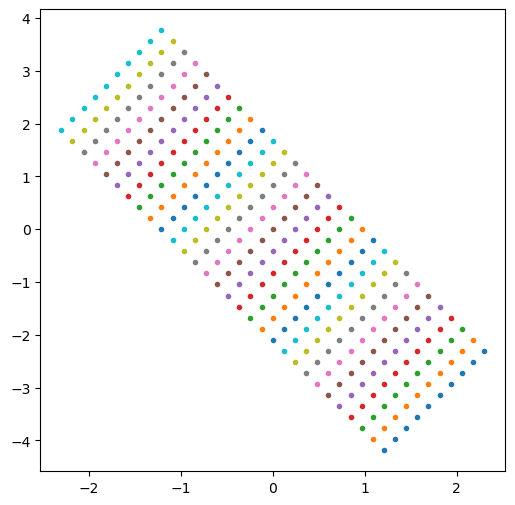

In [4]:
#Define general parameters
L=10 #number of k-points in each direction

#Parameters for Partons with C= -1, -1, +2 (all 3 partons in nu=1/3, charge -e/3)
#take the values vals from Fabian's Code
vals1 = 1/9, 0.0, 0.0, 2*np.pi/3

#Parameters for Partons with C= -1, -1, +2 (1 parton species in nu=2/3 with charge -e/3)
#take the values vals from Fabian's Code
vals21 = 4/9, 0.0, 0.0, 2*np.pi/3

#Parameters for Partons with C= +2, -1, -1 (2 partons of parton species in nu=2/3, charge 2e/3)
#take the values vals from Fabian's Code
vals22 = -4/9, 0.0, 0.0, -2*np.pi/3

#get eigenvectors and eigenenergies/banddispersion
evals1, evecs1 = get_evals_evecs(L, vals1, a1, a2, a3, h1m, h2m)
evals21, evecs21 = get_evals_evecs(L, vals21, a1, a2, a3, h1m, h2m)
evals22, evecs22 = get_evals_evecs(L, vals22, a1, a2, a3, h1m, h2m)

#compute Fermi-energy and the chemical potential for nu=1/3 -> Partons have nu=1
E_F11 = get_energy(evals1, 0, 1, 3) 
mu_11 = get_chempot(evals1, 1, 3)

#compute Fermi-energy and the chemical potential for nu=2/3 -> Partons have nu=2
    #for charge -e/3 partons
E_F21 = get_energy(evals21, 0, 2, 3) 
mu_21 = get_chempot(evals21, 2, 3)
    #for charge 2e/3 partons
E_F22 = get_energy(evals22, 0, 2, 3) 
mu_22 = get_chempot(evals22, 2, 3)

#define Fermi-Dirac and Bose-Einstein summands


#create the grid spanned by h1m, h2m
kGrid, kGridMat = get_mom_grid(L, h1m, h2m)
kGrid_e, kGridMat_e = get_electron_mom_grid(3*L, g1, g2)

#get ksi = energy - chempot
ksi1 = get_ksi(evals1, mu_11)
ksi21 = get_ksi(evals21, mu_21)
ksi22 = get_ksi(evals22, mu_22)

import matplotlib.pyplot as plt
plt.figure(figsize=(6,6))
plt.plot(kGridMat[:,:,0], kGridMat[:,:,1], '.')
plt.show()

In [5]:
def get_C_mat_mat(omg_mats, evecs, bands):
    #omg_mats has shape (N)
    q_len = len(bands[:,0,0])
    N = len(omg_mats)
    C_mat = np.full((q_len, 3*q_len, 3, 3, N), None, dtype=complex)
    Z_mat = np.einsum('kpam, kpbm->kpabm', evecs, np.conj(evecs))

    for qq in range(q_len):
        for pp in range(3*q_len):
            for a in range(3):
                for b in range(3):
                    for n in range(N):
                        C_mat[qq, pp, a, b, n] = np.sum(Z_mat[qq, pp, a, b, :]/(omg_mats[n] - bands[qq, pp, :]))             
    return C_mat

def get_C_mat_mat_vec(omg_mats, evecs, bands):
    """
    Vectorized version of get_C_mat_mat.

    Parameters
    ----------
    omg_mats : (N,) complex (or float) array
        Matsubara frequencies ω_n. If real, you can add a small +i*eta shift.
    evecs : (..., a, m) complex array
        Eigenvectors with indices (k, p, a, m) where a is orbital (size 3).
    bands : (k, p, m) real/complex array
        Band energies ε_{kpm}.
    eta : float, optional
        Small positive broadening; uses ω -> ω + i*eta.

    Returns
    -------
    C_mat : (k, p, a, b, N) complex array
        Orbital-resolved matrix for each (k,p) and ω_n:
        C^{ab}_{kp}(ω_n) = Σ_m Z^{ab}_{kpm} / (ω_n - ε_{kpm}),
        with Z^{ab}_{kpm} = evecs_{kpam} * evecs^*_{kpbm}.
    """
    # Projector weights Z_{k p a b m}
    Z_mat = np.einsum('kpam,kpbm->kpabm', evecs, np.conj(evecs))  # (k,p,3,3,m)

    # 1 / (ω_n - ε) for each (k,p,m,n)
    denom_inv = 1.0 / ( (omg_mats[None, None, None, :])  # (1,1,1,N)
                        - bands[..., None] )                      # (k,p,m,1)
    # Make shapes align to (k,p,m,N)
    denom_inv = denom_inv  # (k,p,m,N)

    # Sum over band index m:  (k,p,a,b,m) * (k,p,m,n) -> (k,p,a,b,n)
    C_mat = np.einsum('kpabm,kpmn->kpabn', Z_mat, denom_inv)

    return C_mat


beta = 50 #inverse temperature beta = 50
M = 1000 #number of negative Matsubara frequencies = number of positive Matsubara frequencies = M
omg_mats = 1j*np.pi*(2*np.arange(-M, M+1)+1)/ beta  #Matsubara frequencies, N=2*M+1

G_Parton1_iwn = get_C_mat_mat_vec(omg_mats, evecs1, ksi1) #nu = 1/3 parton with charge -e/3, 1 band filled with C=-1

G_Parton21_iwn = get_C_mat_mat_vec(omg_mats, evecs21, ksi21) #nu = 2/3 parton with charge 2e/3, 2 bands filled C_ges = -1+2=+1
G_Parton22_iwn = get_C_mat_mat_vec(omg_mats, evecs22, ksi22) #nu = 2/3 2 partons with charge e/3, 2 bands filled C_ges = -1-1 =-2

print(np.min(G_Parton1_iwn), np.max(G_Parton1_iwn))
print(np.min(G_Parton21_iwn), np.max(G_Parton21_iwn))
print(np.min(G_Parton22_iwn), np.max(G_Parton22_iwn))
print(np.min(np.abs(G_Parton1_iwn)), np.max(np.abs(G_Parton1_iwn)), np.mean(np.abs(G_Parton1_iwn)))
print(np.min(np.abs(G_Parton21_iwn)), np.max(np.abs(G_Parton21_iwn)), np.mean(np.abs(G_Parton21_iwn)))
print(np.min(np.abs(G_Parton22_iwn)), np.max(np.abs(G_Parton22_iwn)), np.mean(np.abs(G_Parton22_iwn)))

(-4.705966241839023-0.2888427467221457j) (3.984699867829619+1.8164976084190168j)
(-3.0275501215878893-0.8159580492189669j) (3.0104406288202212+0.12395510355786538j)
(-1.0509108863565968-0.5347396526912429j) (1.322245621125014+0.020739082666610585j)
1.863593415601242e-08 4.7148222025504305 0.021431922873810995
2.981280970679094e-07 3.135577662379305 0.020086642078720626
2.9813172450067667e-07 1.3224082547133948 0.017734370772342814


0.9999999999999999


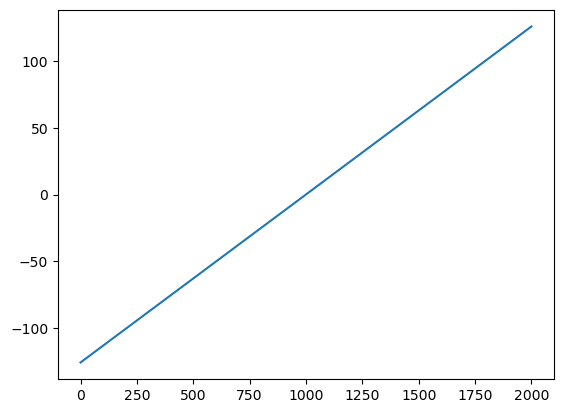

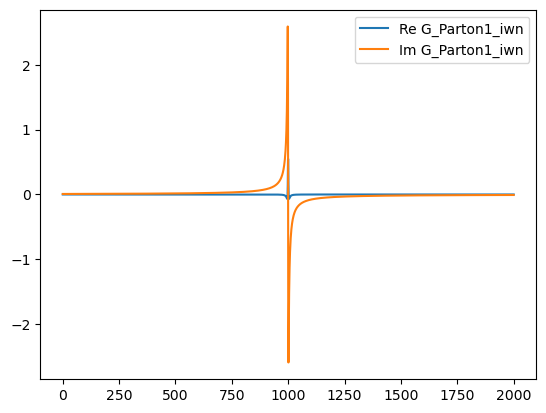

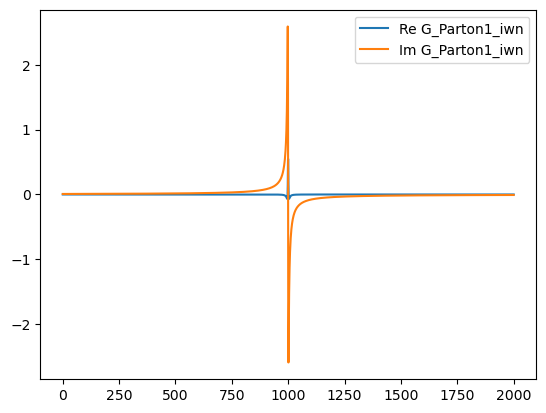

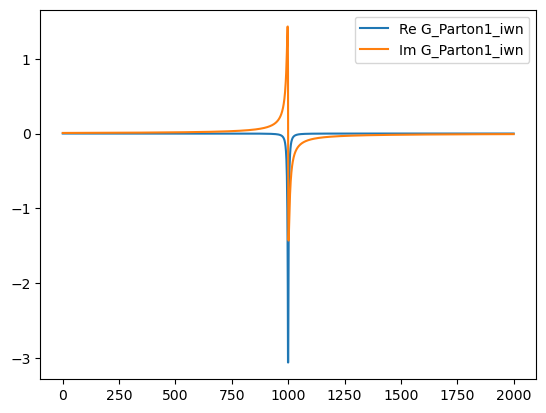

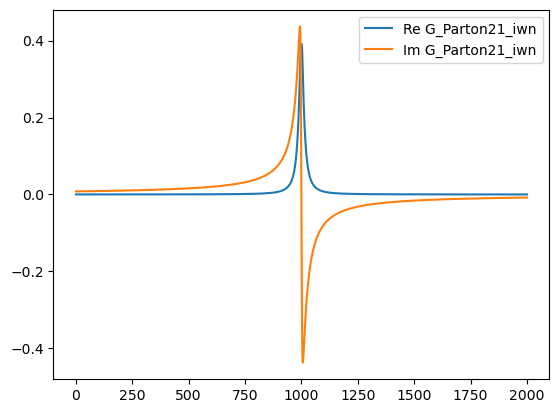

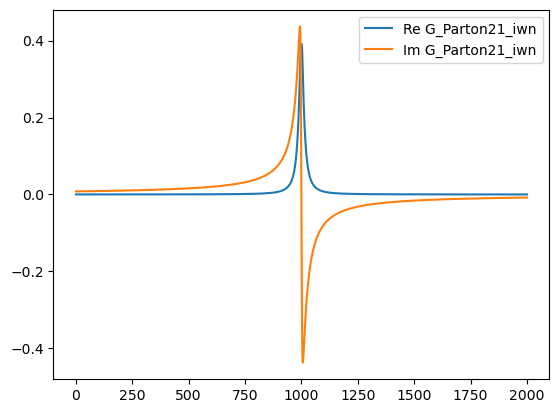

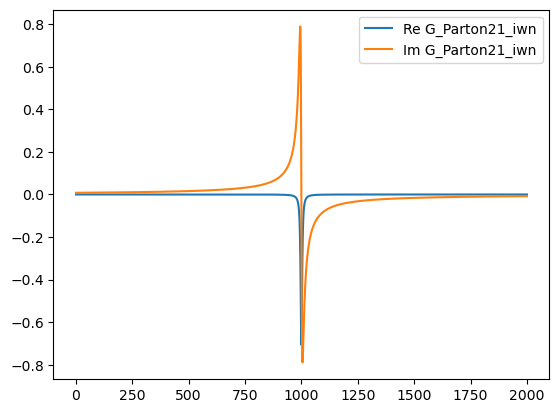

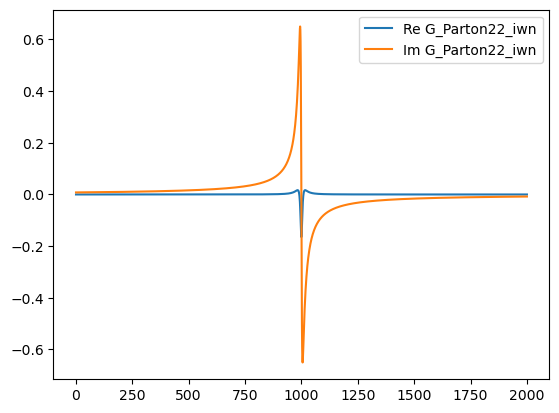

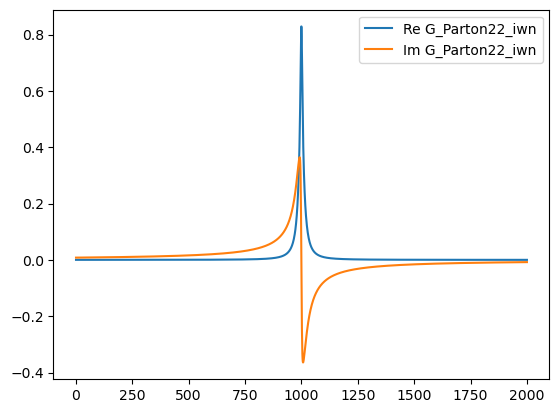

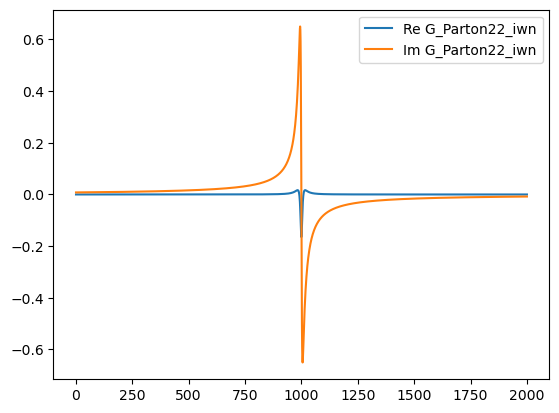

In [6]:
print(np.linalg.norm(evecs1[0,0,2,:]))
plt.plot(np.imag(omg_mats))
plt.show()
plt.plot(np.real(G_Parton1_iwn[L//2,L//2,0,0,:]), label='Re G_Parton1_iwn')
plt.plot(np.imag(G_Parton1_iwn[L//2,L//2,0,0,:]), label='Im G_Parton1_iwn')
plt.legend()
plt.show()
plt.plot(np.real(G_Parton1_iwn[L//2,L//2,1,1,:]), label='Re G_Parton1_iwn')
plt.plot(np.imag(G_Parton1_iwn[L//2,L//2,1,1,:]), label='Im G_Parton1_iwn')
plt.legend()
plt.show()
plt.plot(np.real(G_Parton1_iwn[L//2,L//2,2,2,:]), label='Re G_Parton1_iwn')
plt.plot(np.imag(G_Parton1_iwn[L//2,L//2,2,2,:]), label='Im G_Parton1_iwn')
plt.legend()
plt.show()
plt.plot(np.real(G_Parton21_iwn[L//2,L//2,0,0,:]), label='Re G_Parton21_iwn')
plt.plot(np.imag(G_Parton21_iwn[L//2,L//2,0,0,:]), label='Im G_Parton21_iwn')
plt.legend()
plt.show()
plt.plot(np.real(G_Parton21_iwn[L//2,L//2,1,1,:]), label='Re G_Parton21_iwn')
plt.plot(np.imag(G_Parton21_iwn[L//2,L//2,1,1,:]), label='Im G_Parton21_iwn')
plt.legend()
plt.show()
plt.plot(np.real(G_Parton21_iwn[L//2,L//2,2,2,:]), label='Re G_Parton21_iwn')
plt.plot(np.imag(G_Parton21_iwn[L//2,L//2,2,2,:]), label='Im G_Parton21_iwn')
plt.legend()
plt.show()
plt.plot(np.real(G_Parton22_iwn[L//2,L//2,0,0,:]), label='Re G_Parton22_iwn')
plt.plot(np.imag(G_Parton22_iwn[L//2,L//2,0,0,:]), label='Im G_Parton22_iwn')
plt.legend()
plt.show()
plt.plot(np.real(G_Parton22_iwn[L//2,L//2,1,1,:]), label='Re G_Parton22_iwn')
plt.plot(np.imag(G_Parton22_iwn[L//2,L//2,1,1,:]), label='Im G_Parton22_iwn')
plt.legend()
plt.show()
plt.plot(np.real(G_Parton22_iwn[L//2,L//2,2,2,:]), label='Re G_Parton22_iwn')
plt.plot(np.imag(G_Parton22_iwn[L//2,L//2,2,2,:]), label='Im G_Parton22_iwn')
plt.legend()
plt.show()


In [7]:
#get G^i_ab(x,tau)
def get_G_ab_x_tau(G_ab_iwn_q):
    q_len = len(G_ab_iwn_q[:,0,0,0,0])
    l = len(G_ab_iwn_q[0,0,:,0,0])
    N = len(G_ab_iwn_q[0,0,0,0,:])
    G_x_tau = np.full((q_len, 3*q_len, l, l, N), None, dtype=complex)
    G_iwn_rev = G_ab_iwn_q[:, :, :, :, ::-1] # Reverse the Matsubara frequency order
    m  = np.arange(N)
    ferm_phase = np.exp(-1j * np.pi * (m / N))

    G_x_tau = np.sqrt(N)/beta * fft.ifftn(np.fft.ifftshift(G_iwn_rev, axes=(0, 1, 4)), axes=(0, 1, 4), norm='ortho')
    G_x_tau = G_x_tau * ferm_phase[None, None, None, None, :]
    
    return G_x_tau.astype(np.complex128)

def get_Chi0_ab_x_tau(G1_ab_x_tau, G2_ab_x_tau, G3_ab_x_tau, Fac1, Fac2, Fac3):
    L = len(G1_ab_x_tau[:,0,0,0,0])
    l = len(G1_ab_x_tau[0,0,:,0,0])
    N = len(G1_ab_x_tau[0,0,0,0,:])
    
    idx_minus_r = (-np.arange(L)) % L            # 0→0, 1→L-1, ...
    idy_minus_r = (-np.arange(3*L)) % (3*L)
    idab = np.arange(l)
    idx_beta_minus = (-np.arange(N)) % N      # 0→0, 1→N-1, ...
    G11 = G1_ab_x_tau
    G12 = -np.swapaxes(G1_ab_x_tau[np.ix_(idx_minus_r, idy_minus_r, idab, idab, idx_beta_minus)], 2, 3)
    G12[...,0] *= -1
    G21 = G2_ab_x_tau
    G22 = -np.swapaxes(G2_ab_x_tau[np.ix_(idx_minus_r, idy_minus_r, idab, idab, idx_beta_minus)], 2, 3)
    G22[...,0] *= -1
    G31 = G3_ab_x_tau
    G32 = -np.swapaxes(G3_ab_x_tau[np.ix_(idx_minus_r, idy_minus_r, idab, idab, idx_beta_minus)], 2, 3)
    G32[...,0] *= -1

    Chi0_ab_x_tau_compl = 1/(3*L**2)*Fac2*Fac3*G11*G12+1/(3*L**2)*Fac1*Fac3*G21*G22+1/(3*L**2)*Fac1*Fac2*G31*G32+1/((3*L**2)**3)*G11*G12*G21*G22*G31*G32-1/((3*L**2)**2)*Fac1*G21*G22*G31*G32-1/((3*L**2)**2)*Fac2*G11*G12*G31*G32-1/((3*L**2)**2)*Fac3*G11*G12*G21*G22
    Chi0_ab_x_tau_GGGGGG = 1/((3*L**2)**3)*G11*G12*G21*G22*G31*G32
    Chi0_ab_x_tau_GG1 = 1/(3*L**2)*Fac2*Fac3*G11*G12
    Chi0_ab_x_tau_GG2 = 1/(3*L**2)*Fac1*Fac3*G21*G22
    Chi0_ab_x_tau_GG3 = 1/(3*L**2)*Fac1*Fac2*G31*G32
    Chi0_ab_x_tau_GG1GG3 = -1/((3*L**2)**2)*Fac2*G11*G12*G31*G32
    Chi0_ab_x_tau_GG1GG2 = -1/((3*L**2)**2)*Fac3*G11*G12*G21*G22
    Chi0_ab_x_tau_GG2GG3 = -1/((3*L**2)**2)*Fac1*G21*G22*G31*G32

#PROBLEM FOR GAPLESS: first terms, ESPECIALLY G11G12-term is the PROBLEM!!, but none of them are scaling with L, so the L dependence is correct
    return Chi0_ab_x_tau_compl, Chi0_ab_x_tau_GGGGGG, Chi0_ab_x_tau_GG1, Chi0_ab_x_tau_GG2, Chi0_ab_x_tau_GG3, Chi0_ab_x_tau_GG1GG2, Chi0_ab_x_tau_GG1GG3, Chi0_ab_x_tau_GG2GG3


def get_Chi0_r_tau(Chi0_ab_x_tau):
    L = len(Chi0_ab_x_tau[:,0,0,0,0])
    l = len(Chi0_ab_x_tau[0,0,:,0,0])
    N = len(Chi0_ab_x_tau[0,0,0,0,:])
    Chi0_r_tau = np.zeros((3*L,3*L,N))
    for xx in range(L):
        for yy in range(3*L):
            for a in range(l):
                Chi0_r_tau[3*xx+a,yy,:] = Chi0_ab_x_tau[xx,yy,a,0,:]
    return Chi0_r_tau

def get_Chi0_r_tau_block(Chi0_ab_x_tau):
    # Expect input shape: (L, 3L, l, b, N), using only b=0
    L, threeL, l, bdim, N = Chi0_ab_x_tau.shape
    assert threeL == 3*L, "Second axis must be 3*L."
    assert l <= 3, "This layout maps a∈[0,l) into 3*xx+a; requires l ≤ 3."

    out = np.zeros((3*L, 3*L, N), dtype=Chi0_ab_x_tau.dtype)

    # View output as (L, 3, 3L, N) so row index = 3*xx + a
    out_view = out.reshape(L, 3, 3*L, N)      # (L, 3, 3L, N)
    src = Chi0_ab_x_tau[:, :, :l, 0, :]       # (L, 3L, l, N)
    src = np.transpose(src, (0, 2, 1, 3))     # (L, l, 3L, N)

    out_view[:, :l, :, :] = src               # fills rows 3*xx + a
    return out

def get_Chi0_r_tau_TILDE(Chi0_ab_x_tau):
    L = len(Chi0_ab_x_tau[:,0,0,0,0])
    l = len(Chi0_ab_x_tau[0,0,:,0,0])
    N = len(Chi0_ab_x_tau[0,0,0,0,:])
    Chi0_r_tau = np.zeros((3*L,3*L,N))
    for xx in range(L):
        for yy in range(3*L):
            for a in range(l):
                Chi0_r_tau[2+3*xx-a,yy,:] = Chi0_ab_x_tau[xx,yy,0,a,:]
    return Chi0_r_tau

def get_Chi0_q_ivn(Chi0_r_tau):
    N = len(Chi0_r_tau[0,0,:])
    Chi0_q_ivn_rev = fft.fftn(Chi0_r_tau, axes=(0, 1, 2))
    Chi0_q_ivn_rev = fft.fftshift(Chi0_q_ivn_rev, axes=(0, 1, 2))
    Chi0_q_ivn = Chi0_q_ivn_rev[:, :, ::-1] # Reverse the Matsubara frequency order

    # Include β for the τ integral (since τ grid is mβ/N and NumPy's FFT is a plain sum)
    Chi0_q_ivn *= beta/N
 
    return Chi0_q_ivn.astype(np.complex128)
    


In [8]:
#final calculation of all Greensfunctions and susceptibilities
Fac11 = 1/9
Fac21 = 4/9
Fac22 = 4/9

def get_Chi0_q_ivn_all(G1iwn, G2iwn, G3iwn, Fac1, Fac2, Fac3):
    G1_ab_x_tau = get_G_ab_x_tau(G1iwn)
    G2_ab_x_tau = get_G_ab_x_tau(G2iwn)
    G3_ab_x_tau = get_G_ab_x_tau(G3iwn)
    Chi0_ab_x_tau_compl, Chi0_ab_x_tau_GGGGGG, Chi0_ab_x_tau_GG1, Chi0_ab_x_tau_GG2, Chi0_ab_x_tau_GG3, Chi0_ab_x_tau_GG1GG2, Chi0_ab_x_tau_GG1GG3, Chi0_ab_x_tau_GG2GG3 = get_Chi0_ab_x_tau(G1_ab_x_tau, G2_ab_x_tau, G3_ab_x_tau, Fac1, Fac2, Fac3)
    Chi0_r_tau_compl = get_Chi0_r_tau(Chi0_ab_x_tau_compl)
    Chi0_r_tau_GGGGGG = get_Chi0_r_tau(Chi0_ab_x_tau_GGGGGG)
    Chi0_r_tau_GG1 = get_Chi0_r_tau(Chi0_ab_x_tau_GG1)
    Chi0_r_tau_GG2 = get_Chi0_r_tau(Chi0_ab_x_tau_GG2)
    Chi0_r_tau_GG3 = get_Chi0_r_tau(Chi0_ab_x_tau_GG3)
    Chi0_r_tau_GG1GG2 = get_Chi0_r_tau(Chi0_ab_x_tau_GG1GG2)
    Chi0_r_tau_GG1GG3 = get_Chi0_r_tau(Chi0_ab_x_tau_GG1GG3)
    Chi0_r_tau_GG2GG3 = get_Chi0_r_tau(Chi0_ab_x_tau_GG2GG3)
    Chi0_q_ivn_compl = get_Chi0_q_ivn(Chi0_r_tau_compl)
    Chi0_q_ivn_GGGGGG = get_Chi0_q_ivn(Chi0_r_tau_GGGGGG)
    Chi0_q_ivn_GG1 = get_Chi0_q_ivn(Chi0_r_tau_GG1)
    Chi0_q_ivn_GG2 = get_Chi0_q_ivn(Chi0_r_tau_GG2)
    Chi0_q_ivn_GG3 = get_Chi0_q_ivn(Chi0_r_tau_GG3)
    Chi0_q_ivn_GG1GG2 = get_Chi0_q_ivn(Chi0_r_tau_GG1GG2)
    Chi0_q_ivn_GG1GG3 = get_Chi0_q_ivn(Chi0_r_tau_GG1GG3)
    Chi0_q_ivn_GG2GG3 = get_Chi0_q_ivn(Chi0_r_tau_GG2GG3)
    return Chi0_q_ivn_compl, Chi0_q_ivn_GGGGGG, Chi0_q_ivn_GG1, Chi0_q_ivn_GG2, Chi0_q_ivn_GG3, Chi0_q_ivn_GG1GG2, Chi0_q_ivn_GG1GG3, Chi0_q_ivn_GG2GG3

Chi01_q_ivn_compl, Chi01_q_ivn_GGGGGG, Chi01_q_ivn_GG1, Chi01_q_ivn_GG2, Chi01_q_ivn_GG3, Chi01_q_ivn_GG1GG2, Chi01_q_ivn_GG1GG3, Chi01_q_ivn_GG2GG3 = get_Chi0_q_ivn_all(G_Parton1_iwn, G_Parton1_iwn, G_Parton1_iwn, Fac11, Fac11, Fac11)
Chi02_q_ivn_compl, Chi02_q_ivn_GGGGGG, Chi02_q_ivn_GG1, Chi02_q_ivn_GG2, Chi02_q_ivn_GG3, Chi02_q_ivn_GG1GG2, Chi02_q_ivn_GG1GG3, Chi02_q_ivn_GG2GG3 = get_Chi0_q_ivn_all(G_Parton21_iwn, G_Parton22_iwn, G_Parton22_iwn, Fac21, Fac22, Fac22)


/tmp/ipykernel_167296/3198513188.py:56: ComplexWarning: Casting complex values to real discards the imaginary part
  Chi0_r_tau[3*xx+a,yy,:] = Chi0_ab_x_tau[xx,yy,a,0,:]


In [9]:
#get the Pade approximant of Chi_0_q_ivn at real frequencies
vn_mats = np.pi*(2*np.arange(-M, M))/ beta  
ivn_mats = 1j*2*np.pi*np.arange(0, 804, 4)/ beta  
ivn_mats1 = 1j*2*np.pi*np.arange(0, 201, 1)/ beta
ivn_mats2 = 1j*2*np.pi*np.arange(0, 201, 1)/ beta
ivn_mats1GG = 1j*2*np.pi*np.arange(0, 201, 1)/ beta 
ivn_mats2GG = 1j*2*np.pi*np.arange(0, 201, 1)/ beta 
ivn_mats1GGGG = 1j*2*np.pi*np.arange(0, 402, 2)/ beta
ivn_mats2GGGG = 1j*2*np.pi*np.arange(0, 402, 2)/ beta
ivn_mats1GGGGGG = 1j*2*np.pi*np.arange(0, 804, 4)/ beta
ivn_mats2GGGGGG = 1j*2*np.pi*np.arange(0, 804, 4)/ beta

def get_Xmat(G_iwn, iWn):
    G_iwn = np.asarray(G_iwn, dtype=np.complex128)   # preserve complex
    iWn   = np.asarray(iWn,   dtype=np.complex128)

    L, L, N  = G_iwn.shape
    half  = N // 2
    X     = np.ones((L, L, N, N), dtype=np.complex128)
    SIGMA = np.empty((L, L, N),   dtype=np.complex128)

    # Precompute powers: P[i, j] = (iWn[i])**j
    P = np.power.outer(iWn, np.arange(N, dtype=int))   # shape (N, N)

    exp_sigma = (N - 1) // 2 + 1                       # integer exponent
    for pp in range(L):
        for qq in range(L):
            SIGMA[pp, qq, :]      = G_iwn[pp, qq, :] * P[:, exp_sigma]    # once per qq
            X[pp, qq, :, 1:half]  = P[:, 1:half]                      # cols 1..half-1
            X[pp, qq, :, half:]   = -G_iwn[pp, qq, :, None] * P[:, :N-half]  # cols half..N-1

    return X, SIGMA

def get_pqList(X, SIGMA):
    L, L, N = SIGMA.shape
    pq_list = np.ones((L, L, N), dtype=np.complex128)
    for pp in range(L):
        for qq in range(L):
            pq_list[pp, qq] = np.linalg.solve(X[pp, qq], SIGMA[pp, qq])
    return pq_list


In [10]:
def pade_rational_monic(z, pq, r):
    """
    R(z) = (a0 + a1 z + ... + a_{r-2} z^{r-2}) /
           (z^r + b_{r-1} z^{r-1} + ... + b_1 z + b_0)

    pq layout (length 2r-1): [a0, ..., a_{r-2},  b0, b1, ..., b_{r-1}]
    """
    pq = np.asarray(pq, dtype=np.complex128)
    expect = 2*r - 1
    if pq.size != expect:
        raise ValueError(f"pq must have length {expect} for monic case; got {pq.size}.")
    if r < 2:
        raise ValueError("r must be ≥ 2 (otherwise numerator degree r-2 is invalid).")

    n_coeff = r - 1
    a = pq[:n_coeff]            # a0..a_{r-2}
    b = pq[n_coeff:]            # b0..b_{r-1}

    z = np.asarray(z, dtype=np.complex128)

    # Horner numerator
    num = np.zeros_like(z, dtype=np.complex128)
    for c in a[::-1]:
        num = num*z + c

    # Denominator: z^r + b_{r-1} z^{r-1} + ... + b_0
    den = np.ones_like(z, dtype=np.complex128)  # builds leading z^r
    for c in b[::-1]:
        den = den*z + c

    return num / den

In [11]:
eTa = 0.3*1e-1
OMEGA_real = np.linspace(0.0, 3, 300, dtype=np.complex128)+1j*eTa*np.ones(300, dtype=np.complex128)
OMEGA_real1 = np.linspace(0.0, 3, 300, dtype=np.complex128)+1j*eTa*np.ones(300, dtype=np.complex128)
OMEGA_real2 = np.linspace(0.0, 7, 300, dtype=np.complex128)+1j*eTa*np.ones(300, dtype=np.complex128)

def get_PADE3(OMEGA_real, pq_list, r): #2r-1=M, num deg = r-2, denom deg = r
    L, L, N = pq_list.shape
    PADE_chi_0 = np.ones((L, L, 300), dtype=np.complex128)
    for pp in range(L):
        for qq in range(L):
            PADE_chi_0[pp, qq] = pade_rational_monic(OMEGA_real, pq_list[pp, qq], r)
    return PADE_chi_0

In [12]:
#get Chi from chi_0 by RPA formula
def get_Chi_RPA(Chi0_q_v, V_q):
    L = len(Chi0_q_v[:,0,0])
    N = len(Chi0_q_v[0,0,:])
    Chi_RPA_q_v = np.full((L, L, N), None, dtype=complex)

    for qq in range(L):
        for pp in range(L):
            for n in range(N):
                if 1 - V_q[qq, pp]*Chi0_q_v[qq, pp, n] == 0.0:
                    Chi_RPA_q_v[qq, pp, n] = 0.0
                    print('Denominator = 0.0 at qq, pp, n:', qq, pp, n)
                else:
                    Chi_RPA_q_v[qq, pp, n] = -Chi0_q_v[qq, pp, n]/(1 - V_q[qq, pp]*Chi0_q_v[qq, pp, n])
                    
    return Chi_RPA_q_v.astype(np.complex128)

def get_V_Coulomb_q(qGridMat, e2=1):
    #e2 is the strength of the Coulomb interaction
    L = len(qGridMat[:,0])
    V_q = np.full((L, L), None, dtype=float)
    for qq in range(L):
        for pp in range(L):
            q_len = np.linalg.norm(qGridMat[qq, pp, :])
            if q_len == 0.0:
                V_q[qq, pp] = 0.0  #set V(q=0)=0 to avoid divergence; this is equivalent to a neutralizing background
            else:
                V_q[qq, pp] = e2/(2*q_len)  #Coulomb interaction in 3D space; in 2D it would be e2/(2*eps*q_len)
    return V_q

def get_V_NNconst_q(qGridMat, e=1.0):
    L = len(qGridMat[:,0])
    V_q = np.full((L, L), None, dtype=float)
    for qq in range(L):
        for pp in range(L):
            V_q[qq,pp]=e*(np.cos(2*np.pi*((qq-L//2)/L))+np.cos(2*np.pi*((pp-L//2)/L))+np.cos(2*np.pi*((qq+pp-L)/L)))
    return V_q

def get_V_NN_NNN_NNNN_q(qGridMat, V1, V2, V3):
    L = len(qGridMat[:,0])
    V_q = np.full((L, L), None, dtype=float)
    for qq in range(L):
        for pp in range(L):
            V_q[qq,pp]=V1*(np.cos(2*np.pi*((qq-L//2)/L))+np.cos(2*np.pi*((pp-L//2)/L))+np.cos(2*np.pi*((qq+pp-L)/L)))+V2*(np.cos(2*np.pi*((qq-pp)/L))+np.cos(2*np.pi*(2*qq+pp-3*(L//2))/L)+np.cos(2*np.pi*((2*pp+qq-3*(L//2))/L)))+V3*(np.cos(4*np.pi*((qq-L//2)/L))+np.cos(4*np.pi*((pp-L//2)/L))+np.cos(4*np.pi*((qq+pp-L)/L)))
    return V_q

V_q1 = get_V_Coulomb_q(kGridMat_e, e2=1.3) 
V_q2 = get_V_Coulomb_q(kGridMat_e, e2=0.2)
V_q3 = get_V_Coulomb_q(kGridMat_e, e2=100)
V_qNNc1 = get_V_NNconst_q(kGridMat_e, e=-1.0)
V_qNNc2 = get_V_NNconst_q(kGridMat_e, e=80)
V_qNNc3 = get_V_NNconst_q(kGridMat_e, e=0.8)
V_qNNNN1 = get_V_NN_NNN_NNNN_q(kGridMat_e, 5, -0, -0)
V_qNNNN2 = get_V_NN_NNN_NNNN_q(kGridMat_e, -5, 0.0, -0.0)
V_qNNNN3 = get_V_NN_NNN_NNNN_q(kGridMat_e, 0.2, -0.0, +0.0)
V_qNNNN4 = get_V_NN_NNN_NNNN_q(kGridMat_e, -2.5, -0.0, 0.0)
V_qNNNN5 = get_V_NN_NNN_NNNN_q(kGridMat_e, 2.5, -0, -0.0)

def get_ChiRPA_all(Chi0_q_ivn_compl, V, omega_real, omg_mats, Vscale=9, r=101):
    Chi_q_v_list = []
    for a in range(1, Vscale+1):
        Chi_RPA_q_ivn = get_Chi_RPA(Chi0_q_ivn_compl, a*0.2*V)
        X_Chi_RPA, SIGMA_Chi_RPA = get_Xmat(Chi_RPA_q_ivn[:,:,M:M+(2*r-1):1], omg_mats)
        pq_list_Chi_RPA = get_pqList(X_Chi_RPA, SIGMA_Chi_RPA)
        Chi_q_v = get_PADE3(omega_real, pq_list_Chi_RPA, r)
        Chi_q_v_list.append(Chi_q_v)
    return Chi_q_v_list

def get_ChiRPA_allTILDE(Chi0_q_ivn_compl, V, omega_real, omg_mats, Vscale=9, r=101):
    Chi_q_v_list = []
    for a in range(1, Vscale+1):
        X_Chi0, SIGMA_Chi0 = get_Xmat(Chi0_q_ivn_compl[:,:,M:M+(2*r-1):1], omg_mats)
        pq_list_Chi0 = get_pqList(X_Chi0, SIGMA_Chi0)
        Chi0_q_v = get_PADE3(omega_real, pq_list_Chi0, r)
        Chi_RPA_q_v = get_Chi_RPA(Chi0_q_v, a*0.2*V)
        Chi_q_v_list.append(Chi_RPA_q_v)
    return Chi_q_v_list

def get_Chi1RPA_diagramResTILDE(Chi0_q_ivn_GG1, Chi0_q_ivn_GG1GG2, Chi0_q_ivn_GGGGGG, V1, V2, omega_real, omg_matsGG, omg_matsGGGG, omg_matsGGGGGG, Vscale=9, r=101):
    Chi_q_v_list1 = []
    Chi_q_v_list2 = []
    X_Chi0_GG1, SIGMA_Chi0_GG1 = get_Xmat(Chi0_q_ivn_GG1[:,:,M:M+402:2], omg_matsGG)
    pq_list_Chi0_GG1 = get_pqList(X_Chi0_GG1, SIGMA_Chi0_GG1)
    Chi0_q_v_GG1 = get_PADE3(omega_real, pq_list_Chi0_GG1, 101)

    X_Chi0_GG1GG2, SIGMA_Chi0_GG1GG2 = get_Xmat(Chi0_q_ivn_GG1GG2[:,:,M:M+402:2], omg_matsGGGG)
    pq_list_Chi0_GG1GG2 = get_pqList(X_Chi0_GG1GG2, SIGMA_Chi0_GG1GG2)
    Chi0_q_v_GG1GG2 = get_PADE3(omega_real, pq_list_Chi0_GG1GG2, 101)

    X_Chi0_GGGGGG, SIGMA_Chi0_GGGGGG = get_Xmat(Chi0_q_ivn_GGGGGG[:,:,M:M+804:4], omg_matsGGGGGG)
    pq_list_Chi0_GGGGGG = get_pqList(X_Chi0_GGGGGG, SIGMA_Chi0_GGGGGG)
    Chi0_q_v_GGGGGG = get_PADE3(omega_real, pq_list_Chi0_GGGGGG, 101)
        
    Chi0_compl = Chi0_q_v_GG1+Chi0_q_v_GG1+Chi0_q_v_GG1+Chi0_q_v_GG1GG2+Chi0_q_v_GG1GG2+Chi0_q_v_GG1GG2+Chi0_q_v_GGGGGG
    for a in range(1, Vscale+1):
        Chi_RPA_q_v1 = get_Chi_RPA(Chi0_compl, a*0.2*V1)
        Chi_q_v_list1.append(Chi_RPA_q_v1)
        Chi_RPA_q_v2 = get_Chi_RPA(Chi0_compl, a*0.2*V2)
        Chi_q_v_list2.append(Chi_RPA_q_v2)
    return Chi_q_v_list1, Chi_q_v_list2

def get_Chi2RPA_diagramResTILDE(Chi0_q_ivn_GG1, Chi0_q_ivn_GG3, Chi0_q_ivn_GG1GG2, Chi0_q_ivn_GG2GG3, Chi0_q_ivn_GGGGGG, V1, V2, omega_real, omg_matsGG, omg_matsGGGG, omg_matsGGGGGG, Vscale=9, r=101):
    Chi_q_v_list1 = []
    Chi_q_v_list2 = []

    X_Chi0_GG1, SIGMA_Chi0_GG1 = get_Xmat(Chi0_q_ivn_GG1[:,:,M:M+201:1], omg_matsGG)
    pq_list_Chi0_GG1 = get_pqList(X_Chi0_GG1, SIGMA_Chi0_GG1)
    Chi0_q_v_GG1 = get_PADE3(omega_real, pq_list_Chi0_GG1, 101)

    X_Chi0_GG3, SIGMA_Chi0_GG3 = get_Xmat(Chi0_q_ivn_GG3[:,:,M:M+201:1], omg_matsGG)
    pq_list_Chi0_GG3 = get_pqList(X_Chi0_GG3, SIGMA_Chi0_GG3)
    Chi0_q_v_GG3 = get_PADE3(omega_real, pq_list_Chi0_GG3, 101)

    X_Chi0_GG1GG2, SIGMA_Chi0_GG1GG2 = get_Xmat(Chi0_q_ivn_GG1GG2[:,:,M:M+402:2], omg_matsGGGG)
    pq_list_Chi0_GG1GG2 = get_pqList(X_Chi0_GG1GG2, SIGMA_Chi0_GG1GG2)
    Chi0_q_v_GG1GG2 = get_PADE3(omega_real, pq_list_Chi0_GG1GG2, 101)

    X_Chi0_GG2GG3, SIGMA_Chi0_GG2GG3 = get_Xmat(Chi0_q_ivn_GG2GG3[:,:,M:M+402:2], omg_matsGGGG)
    pq_list_Chi0_GG2GG3 = get_pqList(X_Chi0_GG2GG3, SIGMA_Chi0_GG2GG3)
    Chi0_q_v_GG2GG3 = get_PADE3(omega_real, pq_list_Chi0_GG2GG3, 101)

    X_Chi0_GGGGGG, SIGMA_Chi0_GGGGGG = get_Xmat(Chi0_q_ivn_GGGGGG[:,:,M:M+804:4], omg_matsGGGGGG)
    pq_list_Chi0_GGGGGG = get_pqList(X_Chi0_GGGGGG, SIGMA_Chi0_GGGGGG)
    Chi0_q_v_GGGGGG = get_PADE3(omega_real, pq_list_Chi0_GGGGGG, 101)

    Chi0_compl = Chi0_q_v_GG1+Chi0_q_v_GG3+Chi0_q_v_GG3+Chi0_q_v_GG1GG2+Chi0_q_v_GG2GG3+Chi0_q_v_GG2GG3+Chi0_q_v_GGGGGG
    for a in range(1, Vscale+1):
        Chi_RPA_q_v1 = get_Chi_RPA(Chi0_compl, a*0.2*V1)
        Chi_q_v_list1.append(Chi_RPA_q_v1)
        Chi_RPA_q_v2 = get_Chi_RPA(Chi0_compl, a*0.2*V2)
        Chi_q_v_list2.append(Chi_RPA_q_v2)
    return Chi_q_v_list1, Chi_q_v_list2
        
    

In [13]:
Chi1RPA_diagramResTILDE_list, Chi1RPA_diagramResTILDEattr_list = get_Chi1RPA_diagramResTILDE(Chi01_q_ivn_GG1, Chi01_q_ivn_GG1GG2, Chi01_q_ivn_GGGGGG, V_qNNNN1, V_qNNNN2, OMEGA_real1, ivn_mats1GG, ivn_mats1GGGG, ivn_mats1GGGGGG, Vscale=9, r=101)
Chi2RPA_diagramResTILDE_list, Chi2RPA_diagramResTILDEattr_list = get_Chi2RPA_diagramResTILDE(Chi02_q_ivn_GG1, Chi02_q_ivn_GG3, Chi02_q_ivn_GG1GG2, Chi02_q_ivn_GG2GG3, Chi02_q_ivn_GGGGGG, V_qNNNN5, V_qNNNN4, OMEGA_real2, ivn_mats2GG, ivn_mats2GGGG, ivn_mats2GGGGGG, Vscale=9, r=101)


/tmp/ipykernel_167296/1917446409.py:23: RuntimeWarning: overflow encountered in power
  P = np.power.outer(iWn, np.arange(N, dtype=int))   # shape (N, N)


In [14]:
#Create path in k-space: Gamma-M-K-Gamma
def create_k_path(L):
    path = []
    # Gamma to M
    for i in range(L//2):
        path.append((L//2+i, L//2))
    # M to K
    for i in range(1, L//6 + 1):
        path.append((L - i, 2*i + L//2))
    # K to Gamma
    for i in range(1, L//3 + 1):
        path.append((L//2+L//3 - i, L//2+L//3 - i))
    return path

PATH_GMK = create_k_path(3*L)
qx, qy = np.array(PATH_GMK).T
def ImplementPath(chi_q_v_list, path):
    chi_path_list = []
    V_list = []
    qx, qy = np.array(path).T
    for i, a in enumerate(chi_q_v_list):
        chi_path_list.append(a[qx, qy, :])
        V_list.append(0.2+i*0.2)
    return chi_path_list, V_list

Chi01RPA_q_v_pade1_LIST = get_ChiRPA_all(Chi01_q_ivn_compl, V_qNNNN1, OMEGA_real1, ivn_mats1)
Chi02RPA_q_v_pade1_LIST = get_ChiRPA_all(Chi02_q_ivn_compl, V_qNNNN5, OMEGA_real2, ivn_mats2)
Chi01RPA_q_v_pade1_LISTTILDE = get_ChiRPA_allTILDE(Chi01_q_ivn_compl, V_qNNNN1, OMEGA_real1, ivn_mats1)
Chi02RPA_q_v_pade1_LISTTILDE = get_ChiRPA_allTILDE(Chi02_q_ivn_compl, V_qNNNN5, OMEGA_real2, ivn_mats2)

Chi01RPA_q_v_pade1attr_LIST = get_ChiRPA_all(Chi01_q_ivn_compl, V_qNNNN2, OMEGA_real1, ivn_mats1)
Chi02RPA_q_v_pade1attr_LIST = get_ChiRPA_all(Chi02_q_ivn_compl, V_qNNNN4, OMEGA_real2, ivn_mats2)
Chi01RPA_q_v_pade1attr_LISTTILDE = get_ChiRPA_allTILDE(Chi01_q_ivn_compl, V_qNNNN2, OMEGA_real1, ivn_mats1)
Chi02RPA_q_v_pade1attr_LISTTILDE = get_ChiRPA_allTILDE(Chi02_q_ivn_compl, V_qNNNN4, OMEGA_real2, ivn_mats2)

Chi01RPA_path_list, V1_list = ImplementPath(Chi01RPA_q_v_pade1_LIST, PATH_GMK)
Chi02RPA_path_list, V2_list = ImplementPath(Chi02RPA_q_v_pade1_LIST, PATH_GMK)
Chi01RPAattr_path_list, V1_list = ImplementPath(Chi01RPA_q_v_pade1attr_LIST, PATH_GMK)
Chi02RPAattr_path_list, V2_list = ImplementPath(Chi02RPA_q_v_pade1attr_LIST, PATH_GMK)

Chi01RPA_path_listTILDE, V1_listTILDE = ImplementPath(Chi01RPA_q_v_pade1_LISTTILDE, PATH_GMK)
Chi02RPA_path_listTILDE, V2_listTILDE = ImplementPath(Chi02RPA_q_v_pade1_LISTTILDE, PATH_GMK)
Chi01RPAattr_path_listTILDE, V1_listTILDE = ImplementPath(Chi01RPA_q_v_pade1attr_LISTTILDE, PATH_GMK)
Chi02RPAattr_path_listTILDE, V2_listTILDE = ImplementPath(Chi02RPA_q_v_pade1attr_LISTTILDE, PATH_GMK)

Vs01 = len(V1_list)
Vs02 = len(V2_list)
print(L)

10


In [15]:
Chi1RPA_diagramResTILDE_path_list, V1 = ImplementPath(Chi1RPA_diagramResTILDE_list, PATH_GMK)
Chi2RPA_diagramResTILDE_path_list, V2 = ImplementPath(Chi2RPA_diagramResTILDE_list, PATH_GMK)
Chi1RPA_diagramResTILDEattr_path_list, V1attr = ImplementPath(Chi1RPA_diagramResTILDEattr_list, PATH_GMK)
Chi2RPA_diagramResTILDEattr_path_list, V2attr = ImplementPath(Chi2RPA_diagramResTILDEattr_list, PATH_GMK)

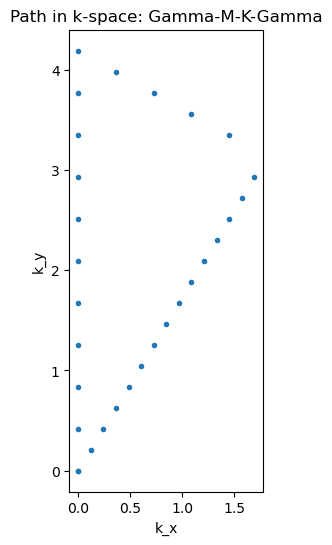

In [16]:
#plot the PATH_GMK
plt.figure(figsize=(2.5,6))
plt.plot(kGridMat_e[qx,qy,0], kGridMat_e[qx,qy,1], '.')
plt.title('Path in k-space: Gamma-M-K-Gamma')
plt.xlabel('k_x')
plt.ylabel('k_y')
plt.show()

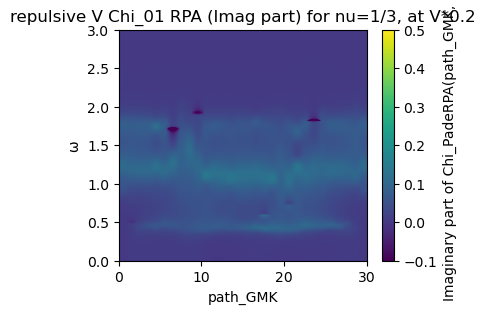

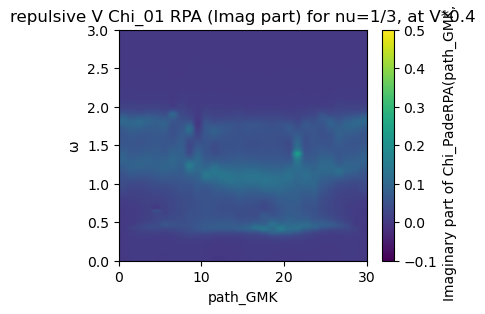

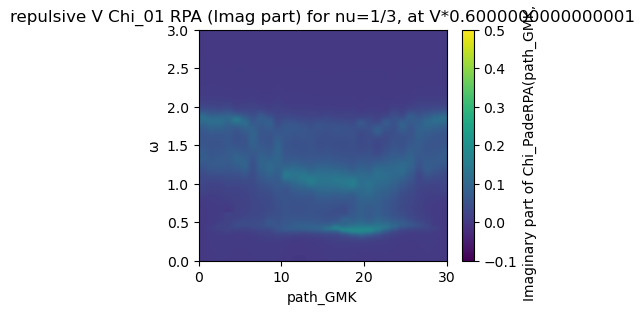

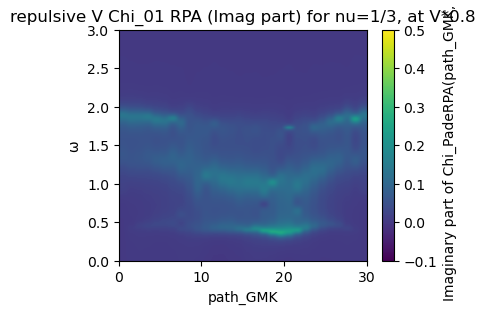

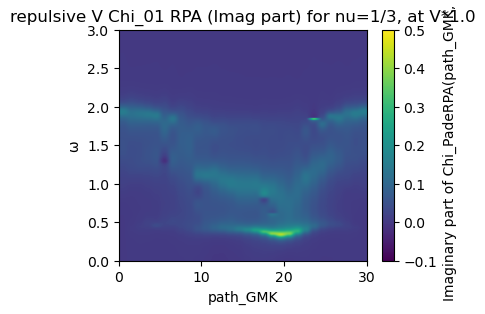

...

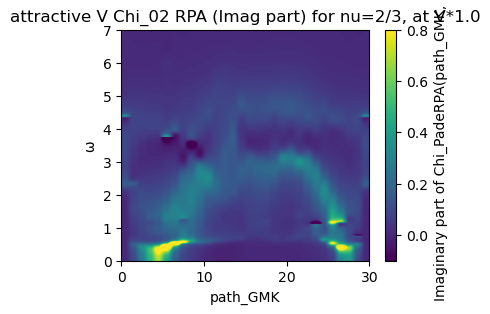

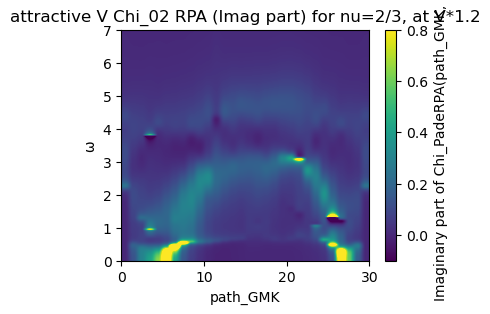

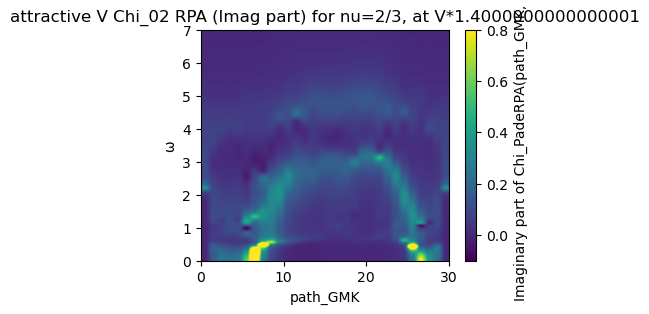

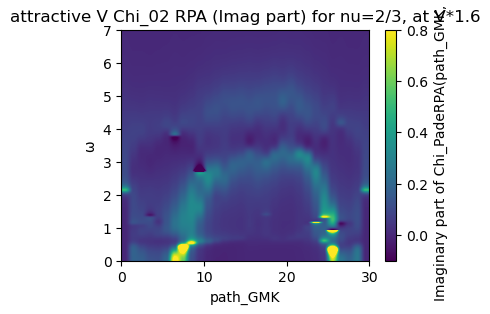

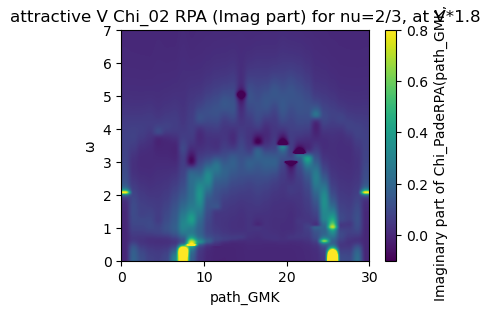

In [17]:
for a in range(Vs01):
    plt.figure(figsize=(4, 3))
    plt.imshow(np.imag(np.transpose(Chi01RPA_path_list[a])), extent=(0, 3*L, 0, 3), origin='lower', aspect='auto', vmin=-0.1, vmax=0.5)
    plt.colorbar(label='Imaginary part of Chi_PadeRPA(path_GMK, :)')
    plt.title('repulsive V Chi_01 RPA (Imag part) for nu=1/3, at V*'+str(V1_list[a]))
    plt.xlabel('path_GMK')
    plt.ylabel('ω')
    plt.show()

for a in range(Vs02):
    plt.figure(figsize=(4, 3))
    plt.imshow(np.imag(np.transpose(Chi02RPA_path_list[a])), extent=(0, 3*L, 0, 7), origin='lower', aspect='auto', vmin=-0.1, vmax=0.8)
    plt.colorbar(label='Imaginary part of Chi_PadeRPA(path_GMK, :)')
    plt.title('repulsive V Chi_02 RPA (Imag part) for nu=2/3, at V*'+str(V2_list[a]))
    plt.xlabel('path_GMK')
    plt.ylabel('ω')
    plt.show()

for a in range(Vs01):
    plt.figure(figsize=(4, 3))
    plt.imshow(np.imag(np.transpose(Chi01RPAattr_path_list[a])), extent=(0, 3*L, 0, 3), origin='lower', aspect='auto', vmin=-0.1, vmax=0.5)
    plt.colorbar(label='Imaginary part of Chi_PadeRPA(path_GMK, :)')
    plt.title('attractive V Chi_01 RPA (Imag part) for nu=1/3, at V*'+str(V1_list[a]))
    plt.xlabel('path_GMK')
    plt.ylabel('ω')
    plt.show()

for a in range(Vs02):
    plt.figure(figsize=(4, 3))
    plt.imshow(np.imag(np.transpose(Chi02RPAattr_path_list[a])), extent=(0, 3*L, 0, 7), origin='lower', aspect='auto', vmin=-0.1, vmax=0.8)
    plt.colorbar(label='Imaginary part of Chi_PadeRPA(path_GMK, :)')
    plt.title('attractive V Chi_02 RPA (Imag part) for nu=2/3, at V*'+str(V2_list[a]))
    plt.xlabel('path_GMK')
    plt.ylabel('ω')
    plt.show()

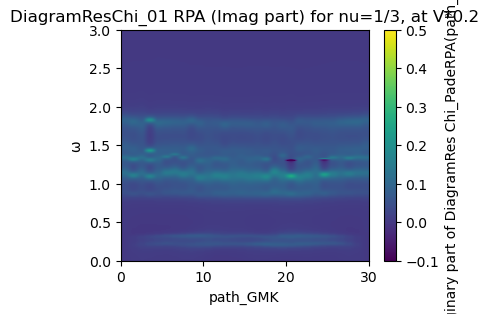

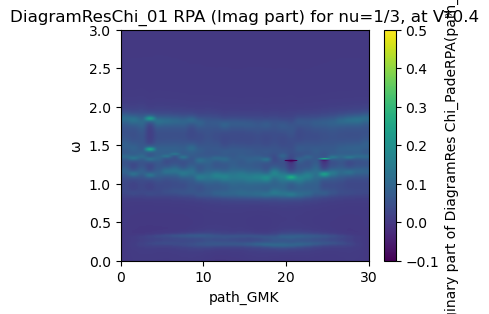

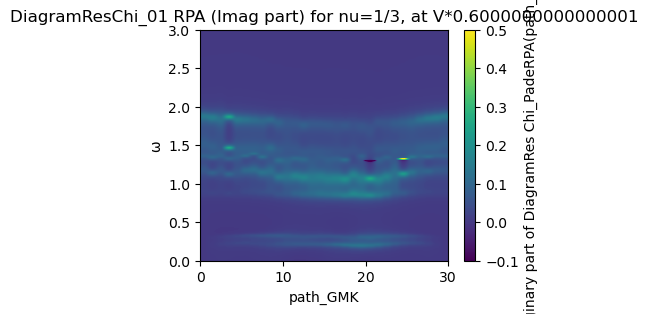

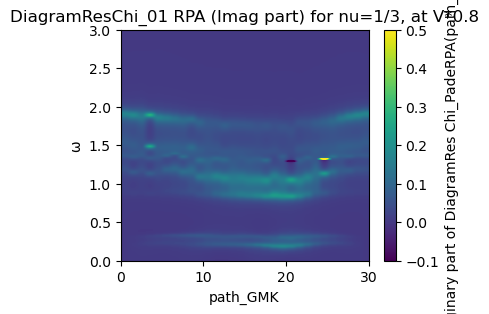

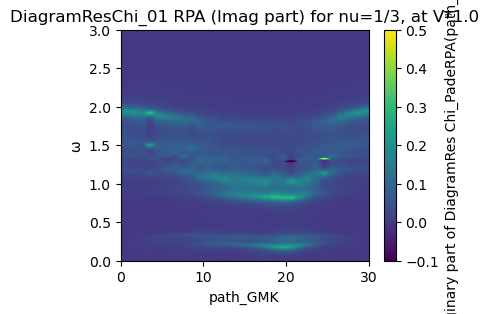

...

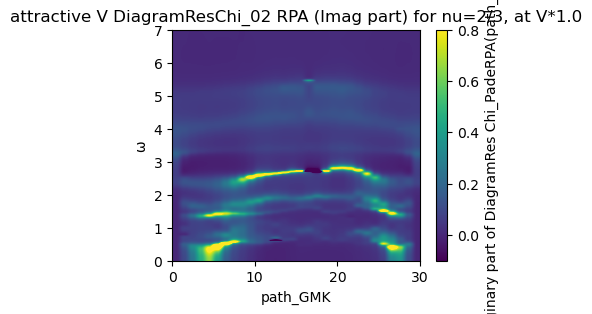

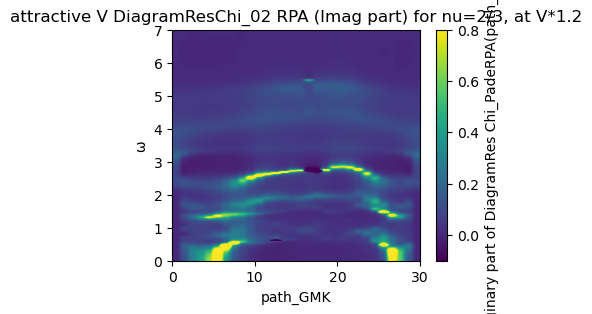

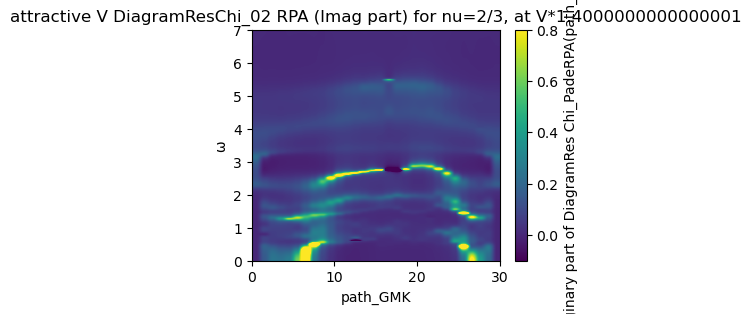

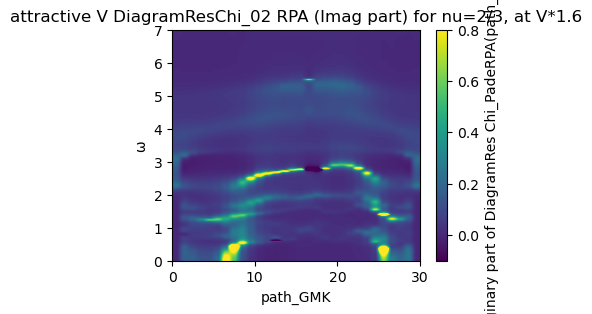

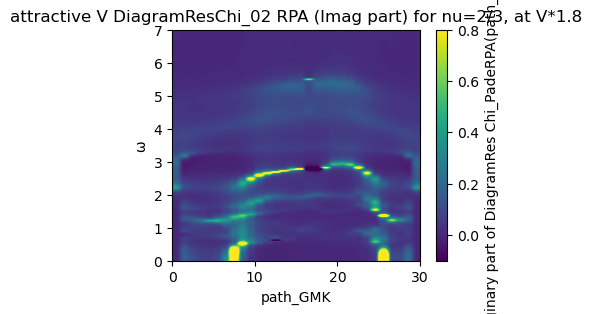

In [18]:
for a in range(Vs01):
    plt.figure(figsize=(4, 3))
    plt.imshow(np.imag(np.transpose(Chi1RPA_diagramResTILDE_path_list[a])), extent=(0, 3*L, 0, 3), origin='lower', aspect='auto', vmin=-0.1, vmax=0.5)
    plt.colorbar(label='Imaginary part of DiagramRes Chi_PadeRPA(path_GMK, :)')
    plt.title('DiagramResChi_01 RPA (Imag part) for nu=1/3, at V*'+str(V1_list[a]))
    plt.xlabel('path_GMK')
    plt.ylabel('ω')
    plt.show()

for a in range(Vs02):
    plt.figure(figsize=(4, 3))
    plt.imshow(np.imag(np.transpose(Chi2RPA_diagramResTILDE_path_list[a])), extent=(0, 3*L, 0, 7), origin='lower', aspect='auto', vmin=-0.1, vmax=0.8)
    plt.colorbar(label='Imaginary part of DiagramRes Chi_PadeRPA(path_GMK, :)')
    plt.title('DiagramResChi_02 RPA (Imag part) for nu=2/3, at V*'+str(V2_list[a]))
    plt.xlabel('path_GMK')
    plt.ylabel('ω')
    plt.show()

for a in range(Vs01):
    plt.figure(figsize=(4, 3))
    plt.imshow(np.imag(np.transpose(Chi1RPA_diagramResTILDEattr_path_list[a])), extent=(0, 3*L, 0, 3), origin='lower', aspect='auto', vmin=-0.1, vmax=0.5)
    plt.colorbar(label='Imaginary part of DiagramRes Chi_PadeRPA(path_GMK, :)')
    plt.title('attractive VDiagramResChi_01 RPA (Imag part) for nu=1/3, at V*'+str(V1_list[a]))
    plt.xlabel('path_GMK')
    plt.ylabel('ω')
    plt.show()

for a in range(Vs02):
    plt.figure(figsize=(4, 3))
    plt.imshow(np.imag(np.transpose(Chi2RPA_diagramResTILDEattr_path_list[a])), extent=(0, 3*L, 0, 7), origin='lower', aspect='auto', vmin=-0.1, vmax=0.8)
    plt.colorbar(label='Imaginary part of DiagramRes Chi_PadeRPA(path_GMK, :)')
    plt.title('attractive V DiagramResChi_02 RPA (Imag part) for nu=2/3, at V*'+str(V2_list[a]))
    plt.xlabel('path_GMK')
    plt.ylabel('ω')
    plt.show()

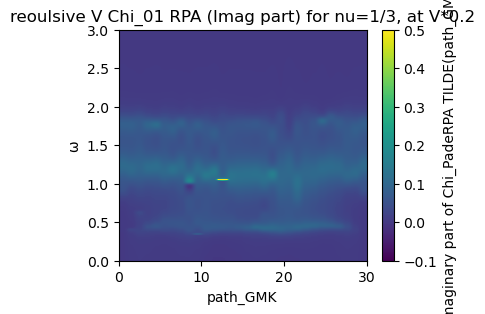

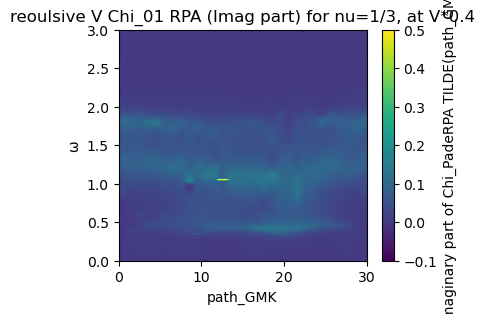

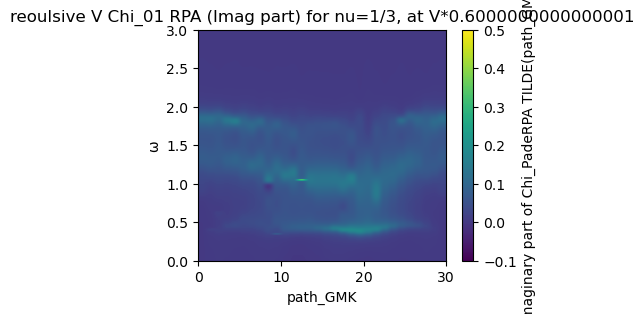

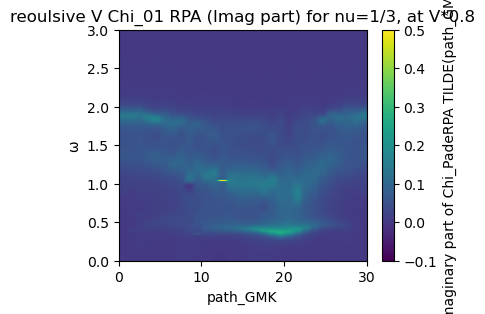

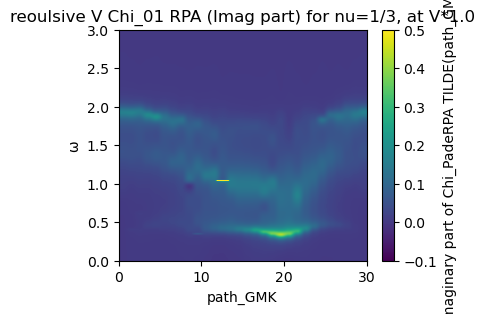

...

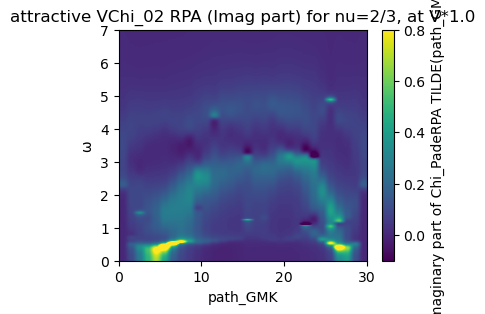

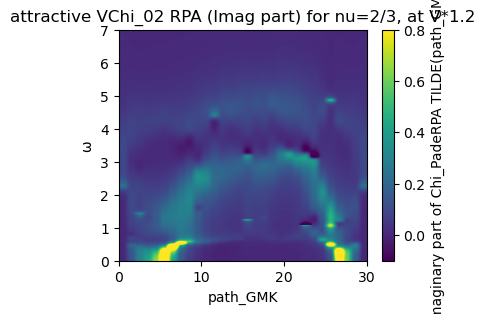

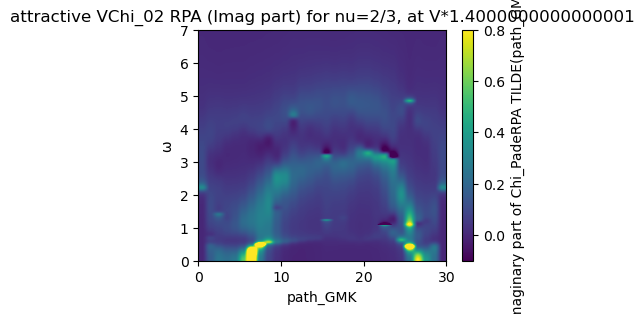

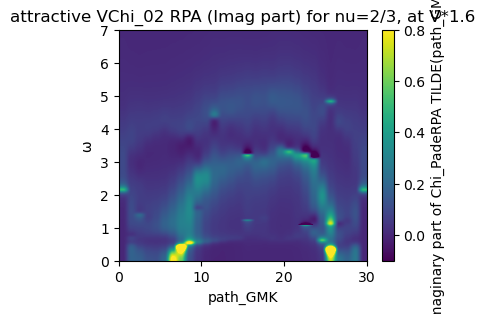

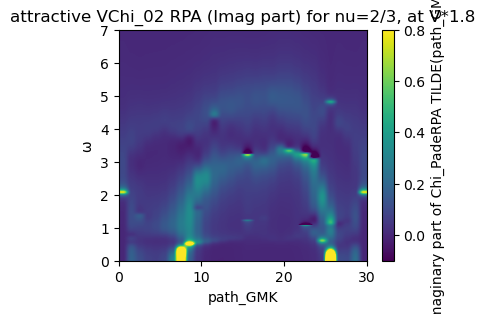

In [19]:
for a in range(Vs01):
    plt.figure(figsize=(4, 3))
    plt.imshow(np.imag(np.transpose(Chi01RPA_path_listTILDE[a])), extent=(0, 3*L, 0, 3), origin='lower', aspect='auto', vmin=-0.1, vmax=0.5)
    plt.colorbar(label='Imaginary part of Chi_PadeRPA TILDE(path_GMK, :)')
    plt.title('reoulsive V Chi_01 RPA (Imag part) for nu=1/3, at V*'+str(V1_list[a]))
    plt.xlabel('path_GMK')
    plt.ylabel('ω')
    plt.show()

for a in range(Vs02):
    plt.figure(figsize=(4, 3))
    plt.imshow(np.imag(np.transpose(Chi02RPA_path_listTILDE[a])), extent=(0, 3*L, 0, 7), origin='lower', aspect='auto', vmin=-0.1, vmax=0.8)
    plt.colorbar(label='Imaginary part of Chi_PadeRPA TILDE(path_GMK, :)')
    plt.title('repulsive V Chi_02 RPA (Imag part) for nu=2/3, at V*'+str(V2_list[a]))
    plt.xlabel('path_GMK')
    plt.ylabel('ω')
    plt.show()

for a in range(Vs01):
    plt.figure(figsize=(4, 3))
    plt.imshow(np.imag(np.transpose(Chi01RPAattr_path_listTILDE[a])), extent=(0, 3*L, 0, 3), origin='lower', aspect='auto', vmin=-0.1, vmax=0.5)
    plt.colorbar(label='Imaginary part of Chi_PadeRPA TILDE(path_GMK, :)')
    plt.title('attractive V Chi_01 RPA (Imag part) for nu=1/3, at V*'+str(V1_list[a]))
    plt.xlabel('path_GMK')
    plt.ylabel('ω')
    plt.show()

for a in range(Vs02):
    plt.figure(figsize=(4, 3))
    plt.imshow(np.imag(np.transpose(Chi02RPAattr_path_listTILDE[a])), extent=(0, 3*L, 0, 7), origin='lower', aspect='auto', vmin=-0.1, vmax=0.8)
    plt.colorbar(label='Imaginary part of Chi_PadeRPA TILDE(path_GMK, :)')
    plt.title('attractive VChi_02 RPA (Imag part) for nu=2/3, at V*'+str(V2_list[a]))
    plt.xlabel('path_GMK')
    plt.ylabel('ω')
    plt.show()

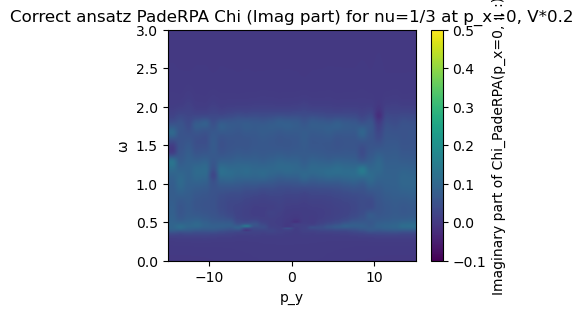

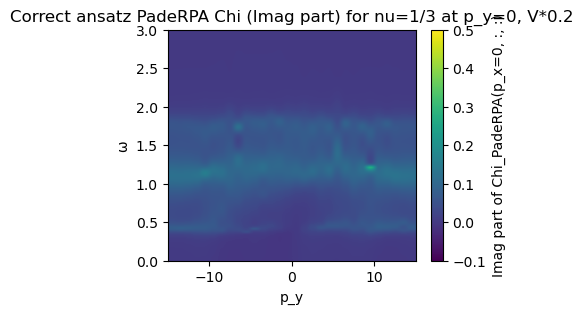

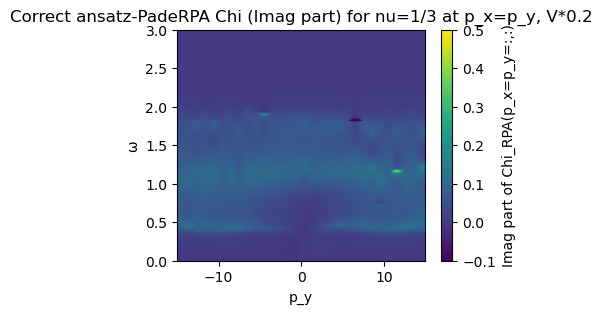

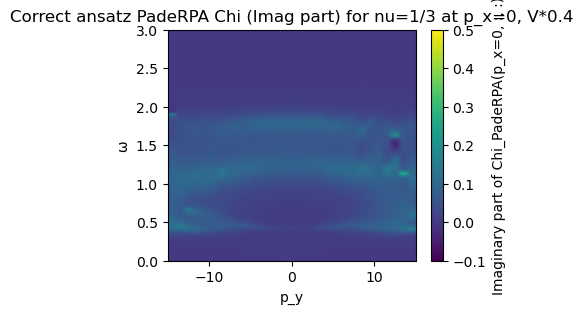

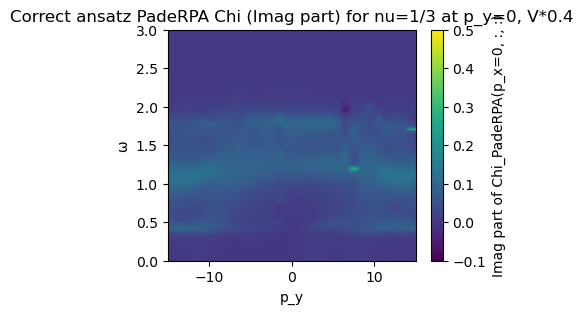

...

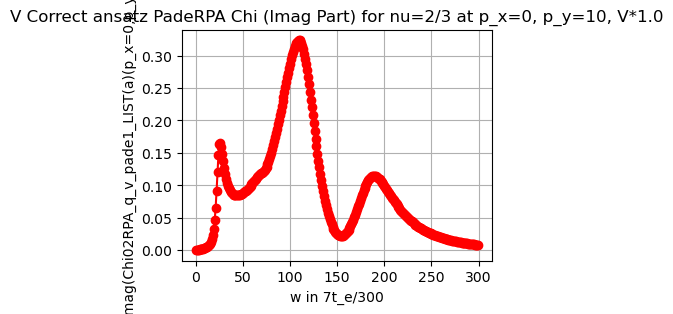

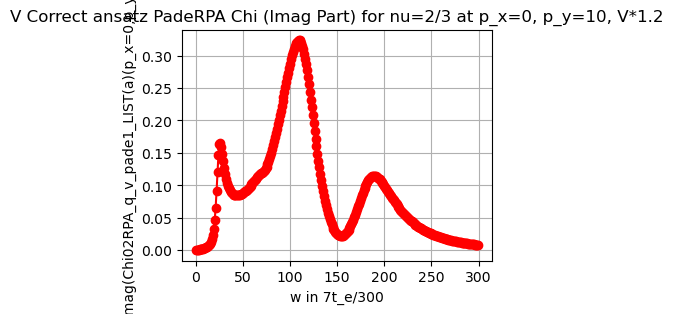

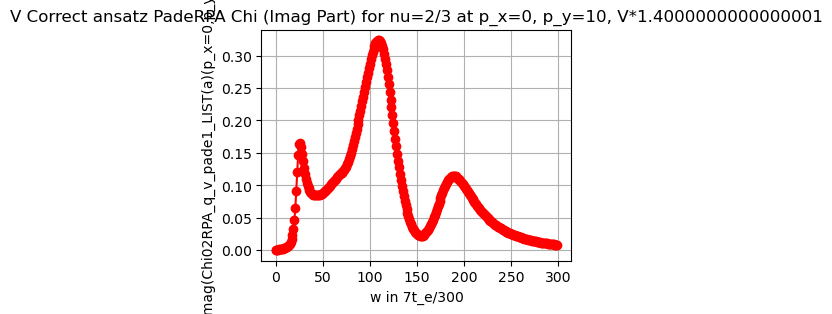

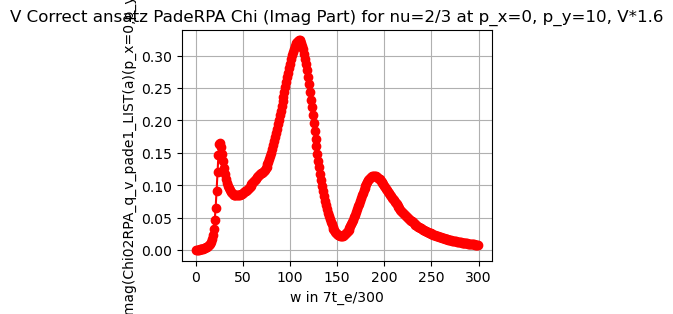

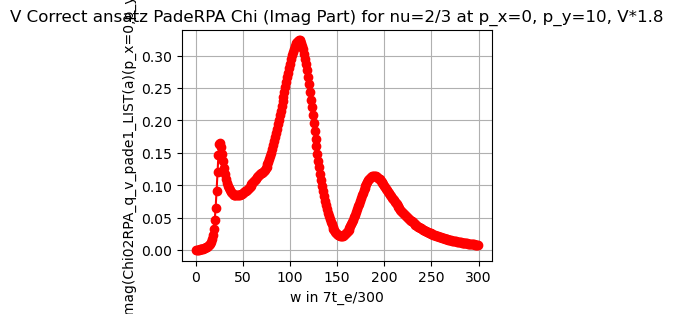

In [20]:
for a in range(Vs01):
    plt.figure(figsize=(4, 3))
    plt.imshow(np.imag(np.transpose(Chi01RPA_q_v_pade1_LIST[a][int(3/2*L)+1, :, :])), extent=(-int(3/2*L), int(3/2*L), 0, 3), origin='lower', aspect='auto', vmin=-0.1, vmax=0.5)
    plt.colorbar(label='Imaginary part of Chi_PadeRPA(p_x=0, :, :)')
    plt.title('Correct ansatz PadeRPA Chi (Imag part) for nu=1/3 at p_x=0, V*'+str(V1_list[a]))
    plt.xlabel('p_y')
    plt.ylabel('ω')
    plt.show()

    plt.figure(figsize=(4, 3))
    plt.imshow(np.imag(np.transpose(Chi01RPA_q_v_pade1_LIST[a][:, int(3/2*L)+1, :])), extent=(-int(3/2*L), int(3/2*L), 0, 3), origin='lower', aspect='auto', vmin=-0.1, vmax=0.5)
    plt.colorbar(label='Imag part of Chi_PadeRPA(p_x=0, :, :)')
    plt.title('Correct ansatz PadeRPA Chi (Imag part) for nu=1/3 at p_y=0, V*'+str(V1_list[a]))
    plt.xlabel('p_y')
    plt.ylabel('ω')
    plt.show()

    plt.figure(figsize=(4, 3))
    Chi01RPA_q_v_pade1diag = np.einsum('iij->ij', Chi01RPA_q_v_pade1_LIST[a])
    plt.imshow(np.imag(np.transpose(Chi01RPA_q_v_pade1diag[:, :])), extent=(-int(3/2*L), int(3/2*L), 0, 3), origin='lower', aspect='auto', vmin=-0.1, vmax=0.5)
    plt.colorbar(label='Imag part of Chi_RPA(p_x=p_y=:,:)')
    plt.title('Correct ansatz-PadeRPA Chi (Imag part) for nu=1/3 at p_x=p_y, V*'+str(V1_list[a]))
    plt.xlabel('p_y')
    plt.ylabel('ω')
    plt.show()

for a in range(Vs02):
    plt.figure(figsize=(4, 3))
    plt.imshow(np.imag(np.transpose(Chi02RPA_q_v_pade1_LIST[a][int(3/2*L)+1, :, :])), extent=(-int(3/2*L), int(3/2*L), 0, 7), origin='lower', aspect='auto', vmin=-0.1, vmax=0.8)
    plt.colorbar(label='Imaginary part of Chi_PadeRPA(p_x=0, :, :)')
    plt.title('V Correct ansatz PadeRPA Chi (Imag part) for nu=2/3 at p_x=0, V*'+str(V2_list[a]))
    plt.xlabel('p_y')
    plt.ylabel('ω')
    plt.show()

    plt.figure(figsize=(4, 3))
    plt.imshow(np.imag(np.transpose(Chi02RPA_q_v_pade1_LIST[a][:, int(3/2*L)+1, :])), extent=(-int(3/2*L), int(3/2*L), 0, 7), origin='lower', aspect='auto', vmin=-0.1, vmax=0.8)
    plt.colorbar(label='Imaginary part of Chi_PadeRPA(:, p_y=0, :)')
    plt.title('V Correct ansatz PadeRPA Chi (Imag part) for nu=2/3 at p_y=0, V*'+str(V2_list[a]))
    plt.xlabel('p_x')
    plt.ylabel('ω')
    plt.show()

    plt.figure(figsize=(4, 3))
    Chi02RPA_q_v_pade1diag = np.einsum('iij->ij', Chi02RPA_q_v_pade1_LIST[a])
    plt.imshow(np.imag(np.transpose(Chi02RPA_q_v_pade1diag[:, :])), extent=(-int(3/2*L), int(3/2*L), 0, 7), origin='lower', aspect='auto', vmin=-0.1, vmax=0.8)
    plt.colorbar(label='Imag part of Chi_RPA(p_x=p_y=:,:)')
    plt.title('V Correct ansatz-PadeRPA Chi (Imag part) for nu=2/3 at p_x=p_y, V*'+str(V2_list[a]))
    plt.xlabel('p_y')
    plt.ylabel('ω')
    plt.show()

for a in range(Vs01):
    plt.figure(figsize=(4, 3))
    plt.plot(range(len(Chi01RPA_q_v_pade1_LIST[a][int(3/2*L), int(3/2*L)+5, :])),np.imag(Chi01RPA_q_v_pade1_LIST[a][int(3/2*L), int(3/2*L)+5, :]), marker='o', linestyle='-', color='r')
    plt.xlabel('w in t_e/100')
    plt.ylabel('np.imag(Chi01RPA_q_v_pade1_LIST(a)(p_x=0,p_y=5))')
    plt.title('Correct ansatz PadeRPA Chi (Imag Part) for nu=1/3 at p_x=0, p_y=5, V*'+str(V1_list[a]))
    plt.grid(True)
    plt.show()

for a in range(Vs02):
    plt.figure(figsize=(4, 3))
    plt.plot(range(len(Chi02RPA_q_v_pade1_LIST[a][int(3/2*L), int(3/2*L)+5, :])),np.imag(Chi02RPA_q_v_pade1_LIST[a][int(3/2*L), int(3/2*L)+5, :]), marker='o', linestyle='-', color='r')
    plt.xlabel('w in 7t_e/300')
    plt.ylabel('np.imag(Chi02RPA_q_v_pade1_LIST(a)(p_x=0,p_y=5))')
    plt.title('V Correct ansatz PadeRPA Chi (Imag Part) for nu=2/3 at p_x=0, p_y=5, V*'+str(V2_list[a]))
    plt.grid(True)
    plt.show()

for a in range(Vs01):
    plt.figure(figsize=(4, 3))
    plt.plot(range(len(Chi01RPA_q_v_pade1_LIST[a][int(3/2*L), int(3/2*L)+10, :])),np.imag(Chi01RPA_q_v_pade1_LIST[a][int(3/2*L), int(3/2*L)+10, :]), marker='o', linestyle='-', color='r')
    plt.xlabel('w in t_e/100')
    plt.ylabel('np.imag(Chi01RPA_q_v_pade1_LIST(a)(p_x=0,p_y=10))')
    plt.title('Correct ansatz PadeRPA Chi (Imag Part) for nu=1/3 at p_x=0, p_y=10, V*'+str(V1_list[a]))
    plt.grid(True)
    plt.show()

for a in range(Vs02):
    plt.figure(figsize=(4, 3))
    plt.plot(range(len(Chi02RPA_q_v_pade1_LIST[a][int(3/2*L), int(3/2*L)+10, :])),np.imag(Chi02RPA_q_v_pade1_LIST[a][int(3/2*L), int(3/2*L)+10, :]), marker='o', linestyle='-', color='r')
    plt.xlabel('w in 7t_e/300')
    plt.ylabel('np.imag(Chi02RPA_q_v_pade1_LIST(a)(p_x=0,p_y=10))')
    plt.title('V Correct ansatz PadeRPA Chi (Imag Part) for nu=2/3 at p_x=0, p_y=10, V*'+str(V2_list[a]))
    plt.grid(True)
    plt.show()

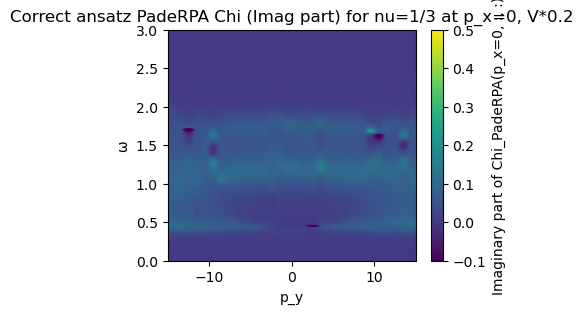

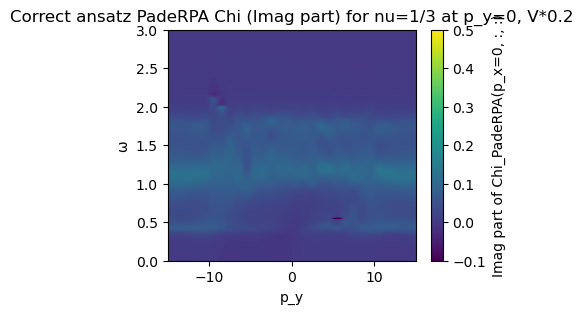

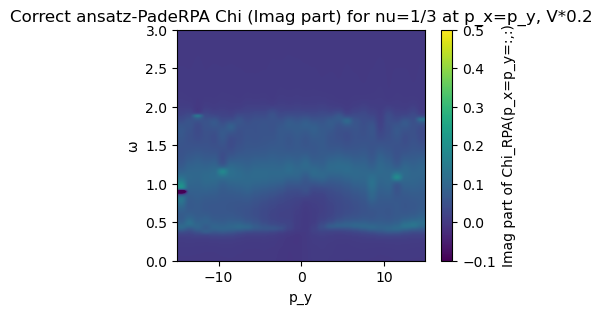

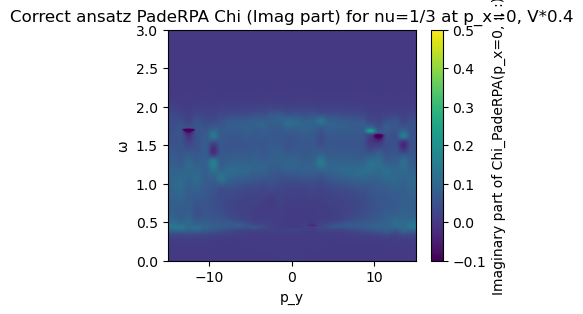

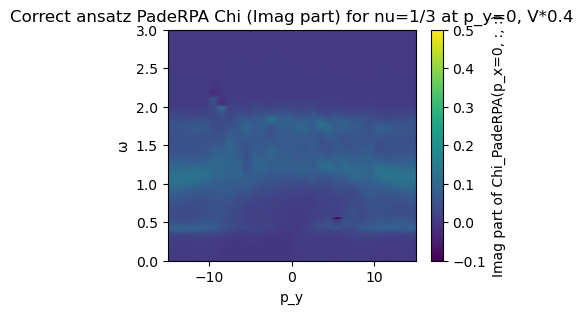

...

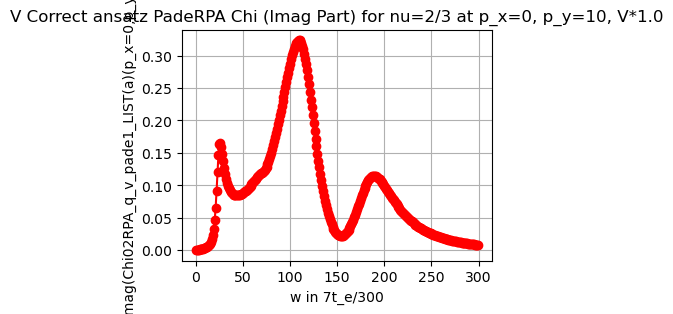

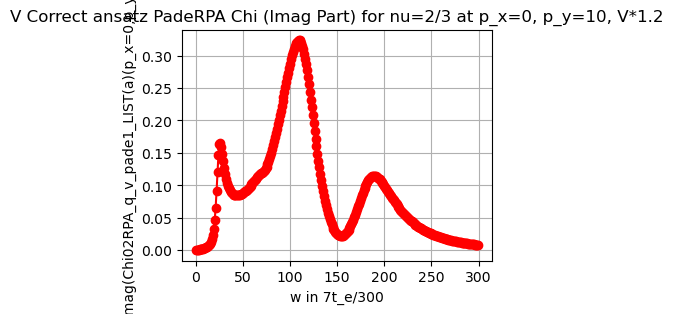

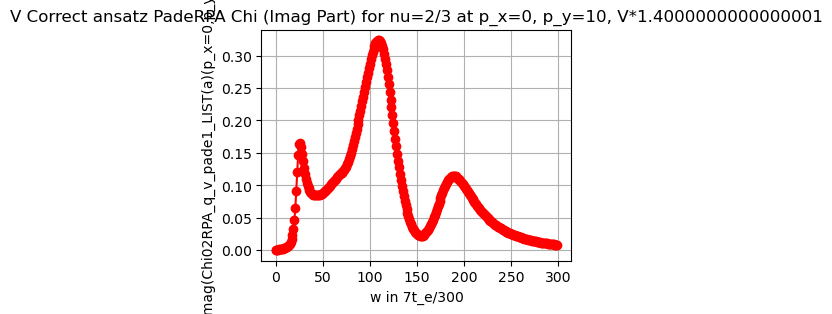

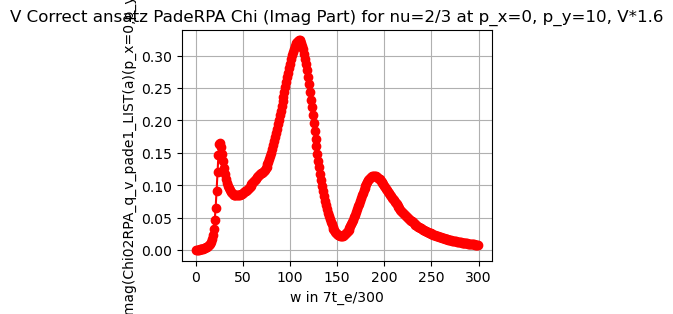

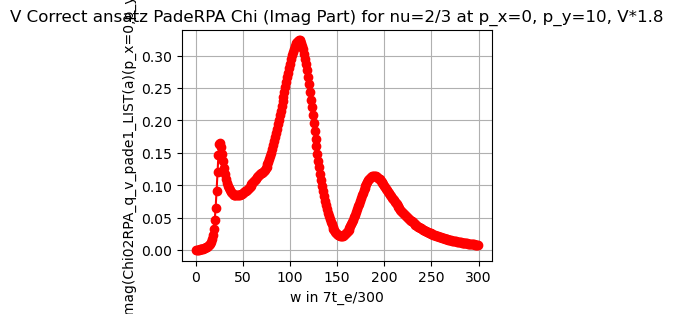

In [21]:
for a in range(Vs01):
    plt.figure(figsize=(4, 3))
    plt.imshow(np.imag(np.transpose(Chi01RPA_q_v_pade1_LISTTILDE[a][int(3/2*L)+1, :, :])), extent=(-int(3/2*L), int(3/2*L), 0, 3), origin='lower', aspect='auto', vmin=-0.1, vmax=0.5)
    plt.colorbar(label='Imaginary part of Chi_PadeRPA(p_x=0, :, :)')
    plt.title('Correct ansatz PadeRPA Chi (Imag part) for nu=1/3 at p_x=0, V*'+str(V1_list[a]))
    plt.xlabel('p_y')
    plt.ylabel('ω')
    plt.show()

    plt.figure(figsize=(4, 3))
    plt.imshow(np.imag(np.transpose(Chi01RPA_q_v_pade1_LISTTILDE[a][:, int(3/2*L)+1, :])), extent=(-int(3/2*L), int(3/2*L), 0, 3), origin='lower', aspect='auto', vmin=-0.1, vmax=0.5)
    plt.colorbar(label='Imag part of Chi_PadeRPA(p_x=0, :, :)')
    plt.title('Correct ansatz PadeRPA Chi (Imag part) for nu=1/3 at p_y=0, V*'+str(V1_list[a]))
    plt.xlabel('p_y')
    plt.ylabel('ω')
    plt.show()

    plt.figure(figsize=(4, 3))
    Chi01RPA_q_v_pade1diagTILDE = np.einsum('iij->ij', Chi01RPA_q_v_pade1_LISTTILDE[a])
    plt.imshow(np.imag(np.transpose(Chi01RPA_q_v_pade1diagTILDE[:, :])), extent=(-int(3/2*L), int(3/2*L), 0, 3), origin='lower', aspect='auto', vmin=-0.1, vmax=0.5)
    plt.colorbar(label='Imag part of Chi_RPA(p_x=p_y=:,:)')
    plt.title('Correct ansatz-PadeRPA Chi (Imag part) for nu=1/3 at p_x=p_y, V*'+str(V1_list[a]))
    plt.xlabel('p_y')
    plt.ylabel('ω')
    plt.show()

for a in range(Vs02):
    plt.figure(figsize=(4, 3))
    plt.imshow(np.imag(np.transpose(Chi02RPA_q_v_pade1_LISTTILDE[a][int(3/2*L)+1, :, :])), extent=(-int(3/2*L), int(3/2*L), 0, 7), origin='lower', aspect='auto', vmin=-0.1, vmax=0.8)
    plt.colorbar(label='Imaginary part of Chi_PadeRPA(p_x=0, :, :)')
    plt.title('V Correct ansatz PadeRPA Chi (Imag part) for nu=2/3 at p_x=0, V*'+str(V2_list[a]))
    plt.xlabel('p_y')
    plt.ylabel('ω')
    plt.show()

    plt.figure(figsize=(4, 3))
    plt.imshow(np.imag(np.transpose(Chi02RPA_q_v_pade1_LISTTILDE[a][:, int(3/2*L)+1, :])), extent=(-int(3/2*L), int(3/2*L), 0, 7), origin='lower', aspect='auto', vmin=-0.1, vmax=0.8)
    plt.colorbar(label='Imaginary part of Chi_PadeRPA(:, p_y=0, :)')
    plt.title('V Correct ansatz PadeRPA Chi (Imag part) for nu=2/3 at p_y=0, V*'+str(V2_list[a]))
    plt.xlabel('p_x')
    plt.ylabel('ω')
    plt.show()

    plt.figure(figsize=(4, 3))
    Chi02RPA_q_v_pade1diagTILDE = np.einsum('iij->ij', Chi02RPA_q_v_pade1_LISTTILDE[a])
    plt.imshow(np.imag(np.transpose(Chi02RPA_q_v_pade1diagTILDE[:, :])), extent=(-int(3/2*L), int(3/2*L), 0, 7), origin='lower', aspect='auto', vmin=-0.1, vmax=0.8)
    plt.colorbar(label='Imag part of Chi_RPA(p_x=p_y=:,:)')
    plt.title('V Correct ansatz-PadeRPA Chi (Imag part) for nu=2/3 at p_x=p_y, V*'+str(V2_list[a]))
    plt.xlabel('p_y')
    plt.ylabel('ω')
    plt.show()

for a in range(Vs01):
    plt.figure(figsize=(4, 3))
    plt.plot(range(len(Chi01RPA_q_v_pade1_LISTTILDE[a][int(3/2*L), int(3/2*L)+5, :])),np.imag(Chi01RPA_q_v_pade1_LIST[a][int(3/2*L), int(3/2*L)+5, :]), marker='o', linestyle='-', color='r')
    plt.xlabel('w in t_e/100')
    plt.ylabel('np.imag(Chi01RPA_q_v_pade1_LIST(a)(p_x=0,p_y=5))')
    plt.title('Correct ansatz PadeRPA Chi (Imag Part) for nu=1/3 at p_x=0, p_y=5, V*'+str(V1_list[a]))
    plt.grid(True)
    plt.show()

for a in range(Vs02):
    plt.figure(figsize=(4, 3))
    plt.plot(range(len(Chi02RPA_q_v_pade1_LISTTILDE[a][int(3/2*L), int(3/2*L)+5, :])),np.imag(Chi02RPA_q_v_pade1_LIST[a][int(3/2*L), int(3/2*L)+5, :]), marker='o', linestyle='-', color='r')
    plt.xlabel('w in 7t_e/300')
    plt.ylabel('np.imag(Chi02RPA_q_v_pade1_LIST(a)(p_x=0,p_y=5))')
    plt.title('V Correct ansatz PadeRPA Chi (Imag Part) for nu=2/3 at p_x=0, p_y=5, V*'+str(V2_list[a]))
    plt.grid(True)
    plt.show()

for a in range(Vs01):
    plt.figure(figsize=(4, 3))
    plt.plot(range(len(Chi01RPA_q_v_pade1_LISTTILDE[a][int(3/2*L), int(3/2*L)+10, :])),np.imag(Chi01RPA_q_v_pade1_LIST[a][int(3/2*L), int(3/2*L)+10, :]), marker='o', linestyle='-', color='r')
    plt.xlabel('w in t_e/100')
    plt.ylabel('np.imag(Chi01RPA_q_v_pade1_LIST(a)(p_x=0,p_y=10))')
    plt.title('Correct ansatz PadeRPA Chi (Imag Part) for nu=1/3 at p_x=0, p_y=10, V*'+str(V1_list[a]))
    plt.grid(True)
    plt.show()

for a in range(Vs02):
    plt.figure(figsize=(4, 3))
    plt.plot(range(len(Chi02RPA_q_v_pade1_LISTTILDE[a][int(3/2*L), int(3/2*L)+10, :])),np.imag(Chi02RPA_q_v_pade1_LIST[a][int(3/2*L), int(3/2*L)+10, :]), marker='o', linestyle='-', color='r')
    plt.xlabel('w in 7t_e/300')
    plt.ylabel('np.imag(Chi02RPA_q_v_pade1_LIST(a)(p_x=0,p_y=10))')
    plt.title('V Correct ansatz PadeRPA Chi (Imag Part) for nu=2/3 at p_x=0, p_y=10, V*'+str(V2_list[a]))
    plt.grid(True)
    plt.show()

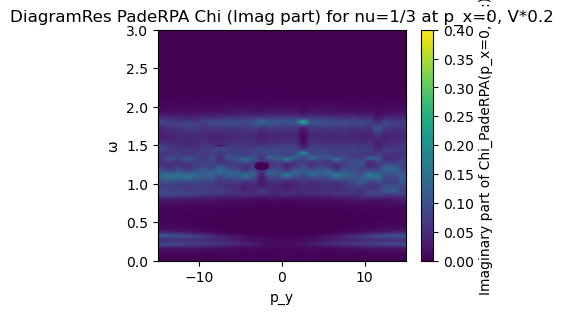

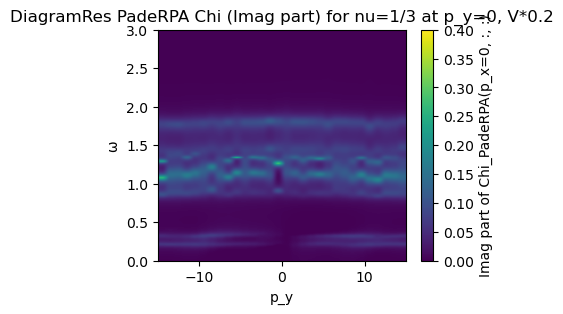

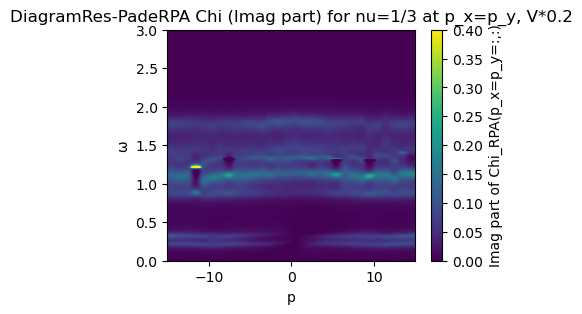

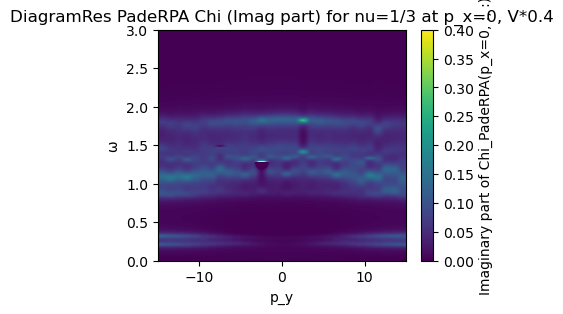

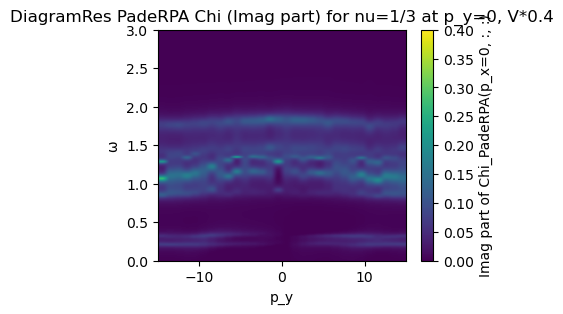

...

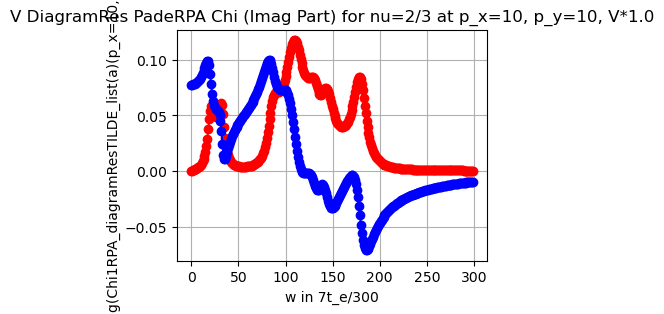

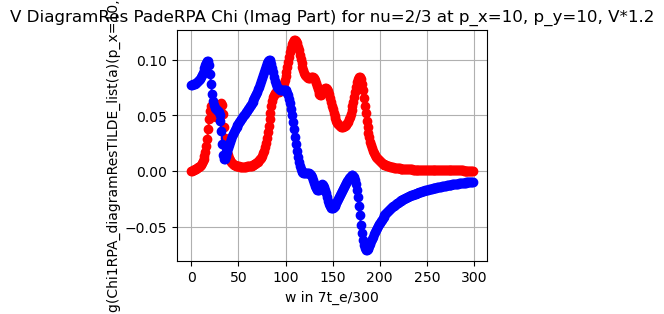

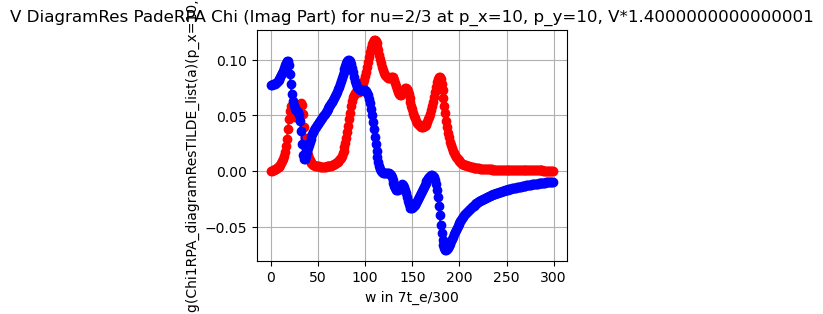

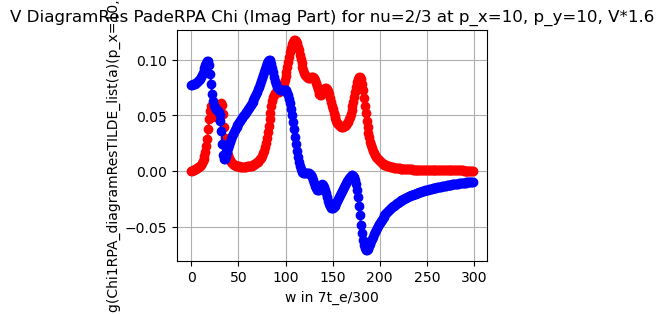

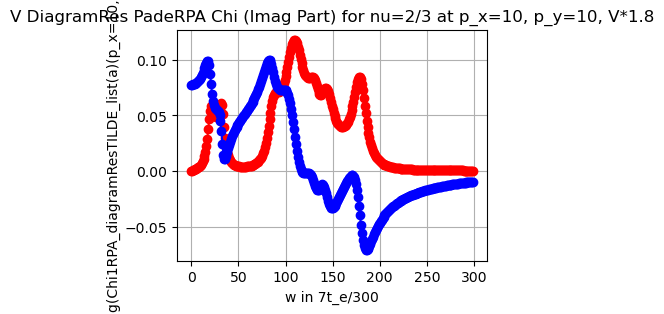

In [22]:
for a in range(Vs01):
    plt.figure(figsize=(4, 3))
    plt.imshow(np.imag(np.transpose(Chi1RPA_diagramResTILDE_list[a][int(3/2*L)+1, :, :])), extent=(-int(3/2*L), int(3/2*L), 0, 3), origin='lower', aspect='auto', vmin=-0, vmax=0.4)
    plt.colorbar(label='Imaginary part of Chi_PadeRPA(p_x=0, :, :)')
    plt.title('DiagramRes PadeRPA Chi (Imag part) for nu=1/3 at p_x=0, V*'+str(V1_list[a]))
    plt.xlabel('p_y')
    plt.ylabel('ω')
    plt.show()

    plt.figure(figsize=(4, 3))
    plt.imshow(np.imag(np.transpose(Chi1RPA_diagramResTILDE_list[a][:, int(3/2*L)+1, :])), extent=(-int(3/2*L), int(3/2*L), 0, 3), origin='lower', aspect='auto', vmin=-0, vmax=0.4)
    plt.colorbar(label='Imag part of Chi_PadeRPA(p_x=0, :, :)')
    plt.title('DiagramRes PadeRPA Chi (Imag part) for nu=1/3 at p_y=0, V*'+str(V1_list[a]))
    plt.xlabel('p_y')
    plt.ylabel('ω')
    plt.show()

    plt.figure(figsize=(4, 3))
    Chi01RPA_q_v_pade1diagresdiagTILDE = np.einsum('iij->ij', Chi1RPA_diagramResTILDE_list[a])
    plt.imshow(np.imag(np.transpose(Chi01RPA_q_v_pade1diagresdiagTILDE[:, :])), extent=(-int(3/2*L), int(3/2*L), 0, 3), origin='lower', aspect='auto', vmin=-0, vmax=0.4)
    plt.colorbar(label='Imag part of Chi_RPA(p_x=p_y=:,:)')
    plt.title('DiagramRes-PadeRPA Chi (Imag part) for nu=1/3 at p_x=p_y, V*'+str(V1_list[a]))
    plt.xlabel('p')
    plt.ylabel('ω')
    plt.show()

for a in range(Vs02):
    plt.figure(figsize=(4, 3))
    plt.imshow(np.imag(np.transpose(Chi1RPA_diagramResTILDE_list[a][int(3/2*L)+1, :, :])), extent=(-int(3/2*L), int(3/2*L), 0, 7), origin='lower', aspect='auto', vmin=-0, vmax=0.4)
    plt.colorbar(label='Imaginary part of Chi_PadeRPA(p_x=0, :, :)')
    plt.title('V DiagramRes PadeRPA Chi (Imag part) for nu=2/3 at p_x=0, V*'+str(V2_list[a]))
    plt.xlabel('p_y')
    plt.ylabel('ω')
    plt.show()

    plt.figure(figsize=(4, 3))
    plt.imshow(np.imag(np.transpose(Chi1RPA_diagramResTILDE_list[a][:, int(3/2*L)+1, :])), extent=(-int(3/2*L), int(3/2*L), 0, 7), origin='lower', aspect='auto', vmin=-0, vmax=0.4)
    plt.colorbar(label='Imaginary part of Chi_PadeRPA(:, p_y=0, :)')
    plt.title('V DiagramRes PadeRPA Chi (Imag part) for nu=2/3 at p_y=0, V*'+str(V2_list[a]))
    plt.xlabel('p_x')
    plt.ylabel('ω')
    plt.show()

    plt.figure(figsize=(4, 3))
    Chi02RPA_q_v_pade1diagresdiagTILDE = np.einsum('iij->ij', Chi1RPA_diagramResTILDE_list[a])
    plt.imshow(np.imag(np.transpose(Chi02RPA_q_v_pade1diagresdiagTILDE[:, :])), extent=(-int(3/2*L), int(3/2*L), 0, 7), origin='lower', aspect='auto', vmin=-0, vmax=0.4)
    plt.colorbar(label='Imag part of Chi_RPA(p_x=p_y=:,:)')
    plt.title('V DiagramRes-PadeRPA Chi (Imag part) for nu=2/3 at p_x=p_y, V*'+str(V2_list[a]))
    plt.xlabel('p')
    plt.ylabel('ω')
    plt.show()

for a in range(Vs01):
    plt.figure(figsize=(4, 3))
    plt.plot(range(len(Chi1RPA_diagramResTILDE_list[a][int(3/2*L), int(3/2*L)+5, :])),np.imag(Chi1RPA_diagramResTILDE_list[a][int(3/2*L), int(3/2*L)+5, :]), marker='o', linestyle='-', color='r')
    plt.plot(range(len(Chi1RPA_diagramResTILDE_list[a][int(3/2*L), int(3/2*L)+5, :])),np.real(Chi1RPA_diagramResTILDE_list[a][int(3/2*L), int(3/2*L)+5, :]), marker='o', linestyle='-', color='b')
    plt.xlabel('w in t_e/100')
    plt.ylabel('np.imag(Chi1RPA_diagramResTILDE_list(a)(p_x=0,p_y=5))')
    plt.title('DiagramRes PadeRPA Chi (Imag Part) for nu=1/3 at p_x=0, p_y=5, V*'+str(V1_list[a]))
    plt.grid(True)
    plt.show()

for a in range(Vs02):
    plt.figure(figsize=(4, 3))
    plt.plot(range(len(Chi1RPA_diagramResTILDE_list[a][int(3/2*L), int(3/2*L)+5, :])),np.imag(Chi1RPA_diagramResTILDE_list[a][int(3/2*L), int(3/2*L)+5, :]), marker='o', linestyle='-', color='r')
    plt.plot(range(len(Chi1RPA_diagramResTILDE_list[a][int(3/2*L), int(3/2*L)+5, :])),np.real(Chi1RPA_diagramResTILDE_list[a][int(3/2*L), int(3/2*L)+5, :]), marker='o', linestyle='-', color='b')
    plt.xlabel('w in 7t_e/300')
    plt.ylabel('np.imag(Chi1RPA_diagramResTILDE_list(a)(p_x=0,p_y=5))')
    plt.title('V DiagramRes PadeRPA Chi (Imag Part) for nu=2/3 at p_x=0, p_y=5, V*'+str(V2_list[a]))
    plt.grid(True)
    plt.show()

for a in range(Vs01):
    plt.figure(figsize=(4, 3))
    plt.plot(range(len(Chi1RPA_diagramResTILDE_list[a][int(3/2*L)+10, int(3/2*L)+10, :])),np.imag(Chi1RPA_diagramResTILDE_list[a][int(3/2*L), int(3/2*L)+10, :]), marker='o', linestyle='-', color='r')
    plt.plot(range(len(Chi1RPA_diagramResTILDE_list[a][int(3/2*L)+10, int(3/2*L)+10, :])),np.real(Chi1RPA_diagramResTILDE_list[a][int(3/2*L), int(3/2*L)+10, :]), marker='o', linestyle='-', color='b')
    plt.xlabel('w in t_e/100')
    plt.ylabel('np.imag(Chi1RPA_diagramResTILDE_list(a)(p_x=10,p_y=10))')
    plt.title('DiagramRes PadeRPA Chi (Imag Part) for nu=1/3 at p_x=10, p_y=10, V*'+str(V1_list[a]))
    plt.grid(True)
    plt.show()

for a in range(Vs02):
    plt.figure(figsize=(4, 3))
    plt.plot(range(len(Chi1RPA_diagramResTILDE_list[a][int(3/2*L)+10, int(3/2*L)+10, :])),np.imag(Chi1RPA_diagramResTILDE_list[a][int(3/2*L), int(3/2*L)+10, :]), marker='o', linestyle='-', color='r')
    plt.plot(range(len(Chi1RPA_diagramResTILDE_list[a][int(3/2*L)+10, int(3/2*L)+10, :])),np.real(Chi1RPA_diagramResTILDE_list[a][int(3/2*L), int(3/2*L)+10, :]), marker='o', linestyle='-', color='b')
    plt.xlabel('w in 7t_e/300')
    plt.ylabel('np.imag(Chi1RPA_diagramResTILDE_list(a)(p_x=10,p_y=10))')
    plt.title('V DiagramRes PadeRPA Chi (Imag Part) for nu=2/3 at p_x=10, p_y=10, V*'+str(V2_list[a]))
    plt.grid(True)
    plt.show()

In [23]:
def omega_summed(ChiRPA_list):
    ChiRPA_list_OmgSummed = []
    for ChiRPA in ChiRPA_list:
        N = len(ChiRPA[0,0,:])
        L3 = len(ChiRPA[:,0,0])
        ChiRPA_OmgSummed = np.zeros((L3, L3))
        for px in range(L3):
            for py in range(L3):
                ChiRPA_OmgSummed[px, py] = np.sum(np.imag(ChiRPA[px, py, :]))
        ChiRPA_list_OmgSummed.append(ChiRPA_OmgSummed)
    return ChiRPA_list_OmgSummed

Chi1RPA_diagramResTILDE_list_OmgSummed = omega_summed(Chi1RPA_diagramResTILDE_list) 
Chi1RPA_diagramResTILDEattr_list_OmgSummed = omega_summed(Chi1RPA_diagramResTILDEattr_list)
Chi2RPA_diagramResTILDE_list_OmgSummed = omega_summed(Chi2RPA_diagramResTILDE_list) 
Chi2RPA_diagramResTILDEattr_list_OmgSummed = omega_summed(Chi2RPA_diagramResTILDEattr_list)

Chi01RPA_q_v_pade1_LIST_OmgSummed = omega_summed(Chi01RPA_q_v_pade1_LIST)
Chi01RPA_q_v_pade1_LISTTILDE_OmgSummed = omega_summed(Chi01RPA_q_v_pade1_LISTTILDE)
Chi02RPA_q_v_pade1_LIST_OmgSummed = omega_summed(Chi02RPA_q_v_pade1_LIST)
Chi02RPA_q_v_pade1_LISTTILDE_OmgSummed = omega_summed(Chi02RPA_q_v_pade1_LISTTILDE)

Chi01RPA_q_v_pade1attr_LIST_OmgSummed = omega_summed(Chi01RPA_q_v_pade1attr_LIST)
Chi01RPA_q_v_pade1attr_LISTTILDE_OmgSummed = omega_summed(Chi01RPA_q_v_pade1attr_LISTTILDE)
Chi02RPA_q_v_pade1attr_LIST_OmgSummed = omega_summed(Chi02RPA_q_v_pade1attr_LIST)
Chi02RPA_q_v_pade1attr_LISTTILDE_OmgSummed = omega_summed(Chi02RPA_q_v_pade1attr_LISTTILDE)


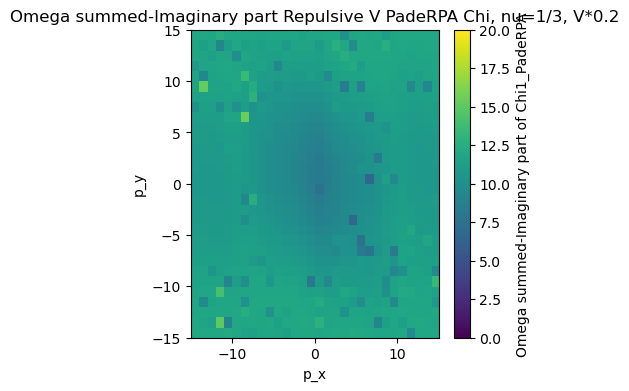

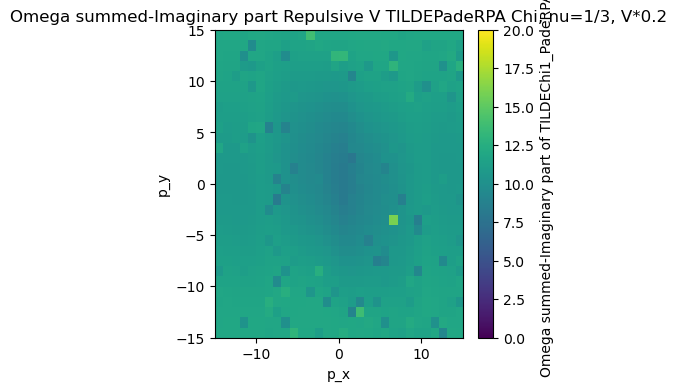

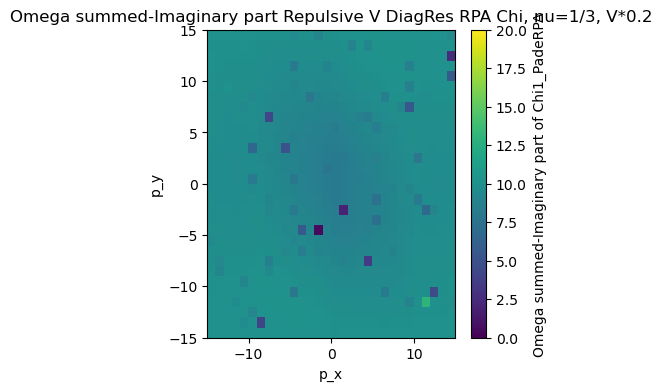

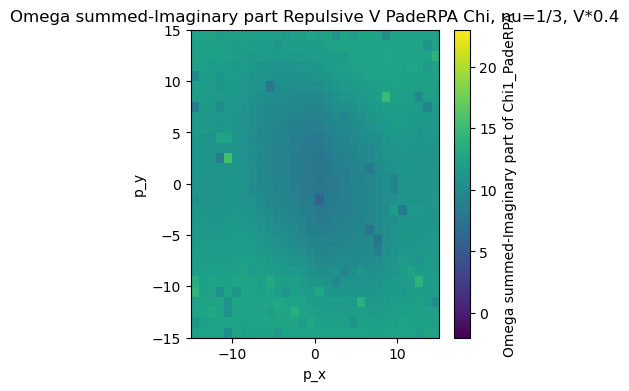

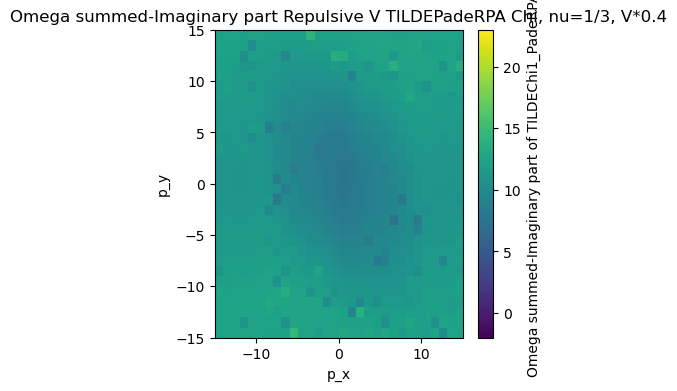

...

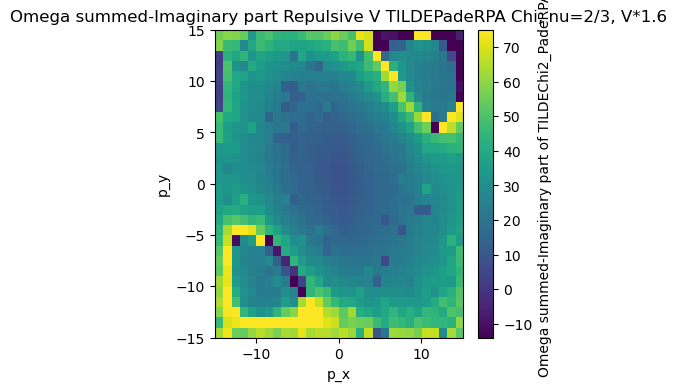

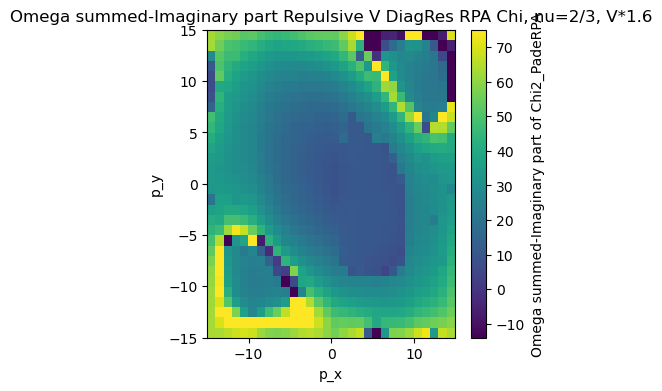

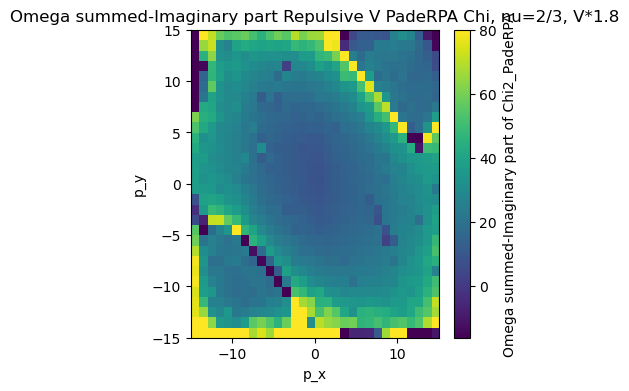

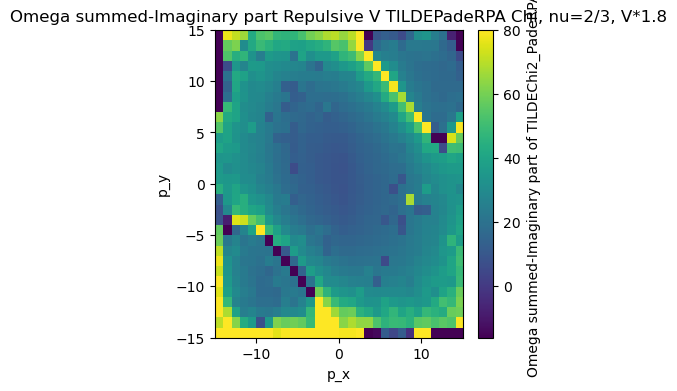

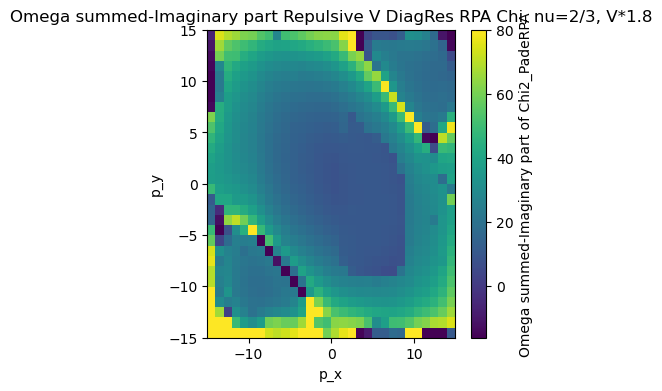

In [24]:
for a in range(Vs02):
    plt.figure(figsize=(4,4))
    plt.imshow((np.transpose(Chi01RPA_q_v_pade1_LIST_OmgSummed[a])), extent=(-int(3/2*L), int(3/2*L), -int(3/2*L), int(3/2*L)), origin='lower', aspect='auto', vmin=-a*2, vmax=20+a*3)
    plt.colorbar(label='Omega summed-Imaginary part of Chi1_PadeRPA')
    plt.title('Omega summed-Imaginary part Repulsive V PadeRPA Chi, nu=1/3, V*'+str(V2_list[a]))
    plt.xlabel('p_x')
    plt.ylabel('p_y')
    plt.show()
    plt.figure(figsize=(4,4))
    plt.imshow((np.transpose(Chi01RPA_q_v_pade1_LISTTILDE_OmgSummed[a])), extent=(-int(3/2*L), int(3/2*L), -int(3/2*L), int(3/2*L)), origin='lower', aspect='auto', vmin=-a*2, vmax=20+a*3)
    plt.colorbar(label='Omega summed-Imaginary part of TILDEChi1_PadeRPA')
    plt.title('Omega summed-Imaginary part Repulsive V TILDEPadeRPA Chi, nu=1/3, V*'+str(V2_list[a]))
    plt.xlabel('p_x')
    plt.ylabel('p_y')
    plt.show()
    plt.figure(figsize=(4,4))
    plt.imshow((np.transpose(Chi1RPA_diagramResTILDE_list_OmgSummed[a])), extent=(-int(3/2*L), int(3/2*L), -int(3/2*L), int(3/2*L)), origin='lower', aspect='auto', vmin=-a*2, vmax=20+a*3)
    plt.colorbar(label='Omega summed-Imaginary part of Chi1_PadeRPA')
    plt.title('Omega summed-Imaginary part Repulsive V DiagRes RPA Chi, nu=1/3, V*'+str(V2_list[a]))
    plt.xlabel('p_x')
    plt.ylabel('p_y')
    plt.show()

for a in range(Vs02):
    plt.figure(figsize=(4,4))
    plt.imshow((np.transpose(Chi02RPA_q_v_pade1_LIST_OmgSummed[a])), extent=(-int(3/2*L), int(3/2*L), -int(3/2*L), int(3/2*L)), origin='lower', aspect='auto', vmin=-a*2, vmax=40+a*5)
    plt.colorbar(label='Omega summed-Imaginary part of Chi2_PadeRPA')
    plt.title('Omega summed-Imaginary part Repulsive V PadeRPA Chi, nu=2/3, V*'+str(V2_list[a]))
    plt.xlabel('p_x')
    plt.ylabel('p_y')
    plt.show()
    plt.figure(figsize=(4,4))
    plt.imshow((np.transpose(Chi02RPA_q_v_pade1_LISTTILDE_OmgSummed[a])), extent=(-int(3/2*L), int(3/2*L), -int(3/2*L), int(3/2*L)), origin='lower', aspect='auto', vmin=-a*2, vmax=40+a*5)
    plt.colorbar(label='Omega summed-Imaginary part of TILDEChi2_PadeRPA')
    plt.title('Omega summed-Imaginary part Repulsive V TILDEPadeRPA Chi, nu=2/3, V*'+str(V2_list[a]))
    plt.xlabel('p_x')
    plt.ylabel('p_y')
    plt.show()
    plt.figure(figsize=(4,4))
    plt.imshow((np.transpose(Chi2RPA_diagramResTILDE_list_OmgSummed[a])), extent=(-int(3/2*L), int(3/2*L), -int(3/2*L), int(3/2*L)), origin='lower', aspect='auto', vmin=-a*2, vmax=40+a*5)
    plt.colorbar(label='Omega summed-Imaginary part of Chi2_PadeRPA')
    plt.title('Omega summed-Imaginary part Repulsive V DiagRes RPA Chi, nu=2/3, V*'+str(V2_list[a]))
    plt.xlabel('p_x')
    plt.ylabel('p_y')
    plt.show()